In [1]:
from anndata import read_h5ad
import pandas as pd
import numpy as np
import scvi
import scanpy as sc

%load_ext nb_black
use_cuda = True


In [2]:
import sys
data_path = "../../../TabulaSapiensData/"
ts_path = "../"
sys.path.append(ts_path)


In [3]:
import matplotlib.pyplot as plt

%matplotlib inline

In [4]:
adata = read_h5ad(data_path + "decontX/Pilot1_Pilot2.decontX.h5ad")

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if not is_categorical(df_full[k]):
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/numba/np/ufunc/parallel.py:363: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9002. The TBB threading layer is disabled.
  warnings.warn(problem)
/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


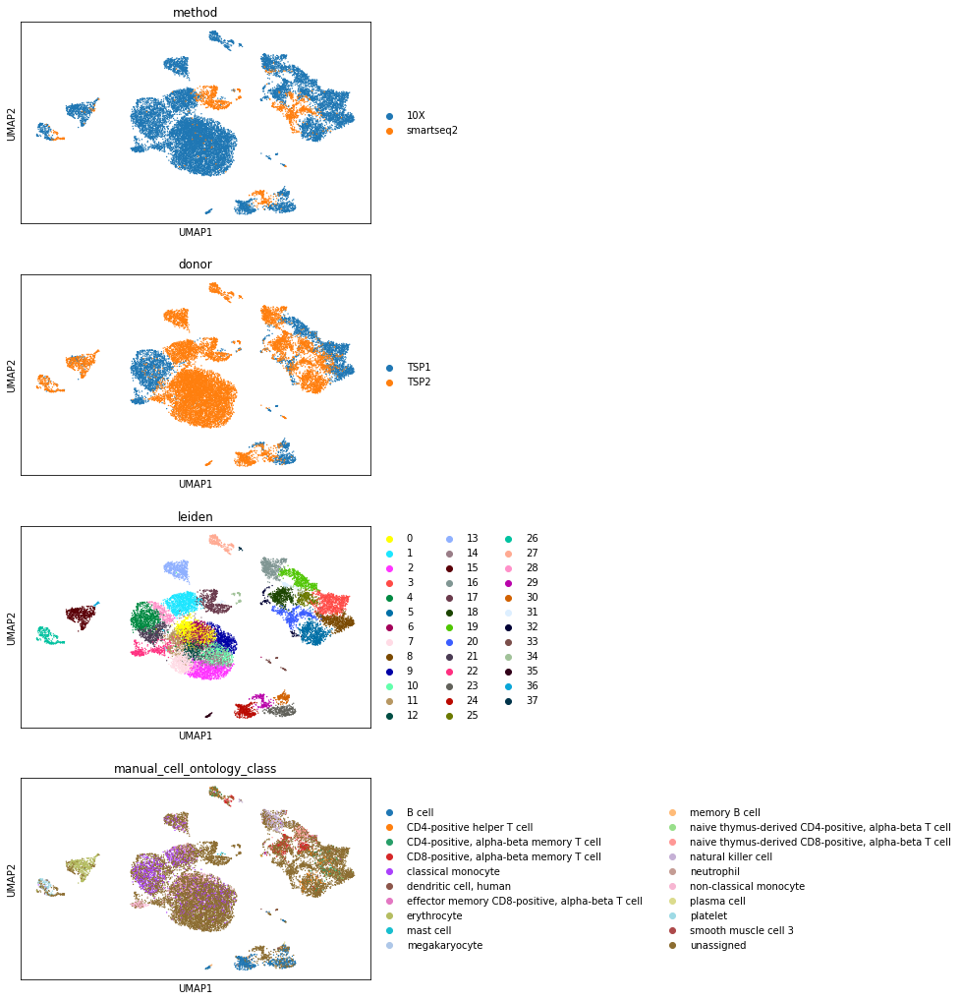

In [5]:
organ = "Blood"
organ_adata = adata[adata.obs["tissue"] == organ]
sc.pp.neighbors(organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(organ_adata)
organ_adata.obsm["X_umap_decontX"] = organ_adata.obsm["X_umap"].copy()
sc.tl.leiden(organ_adata, resolution=2)
sc.pl.umap(
    organ_adata,
    color=["method", "donor", "leiden", "manual_cell_ontology_class"],
    ncols=1,
)
organ_adata.X = np.log1p(organ_adata.X)

# cluster to celltype correspondance
count is a matrix of cluster-cell type correspondance, where each row is a celltype, and each colum is a cluster. The entries to the matrix is the number of cells that is annotated as celltype *X* and cluster *Y*

In [6]:
count = {}
for c in np.unique(organ_adata.obs["leiden"]):
    count[c] = {}
    for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
        count[c][t] = np.sum(
            (organ_adata.obs["leiden"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )

count = pd.DataFrame.from_dict(count)

We can visualize the cluster assignment of each cell type through this heatmap. The color is normalized for each celltype 

<AxesSubplot:>

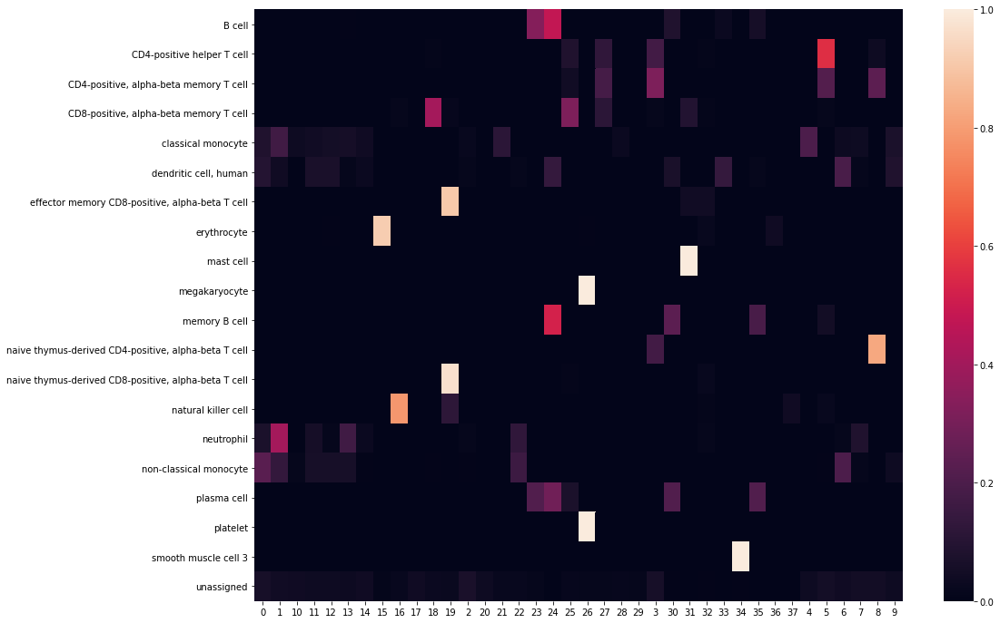

In [7]:
import seaborn

plt.figure(figsize=(16, 12))
seaborn.heatmap((count.T / count.sum(axis=1)).T)

# dictionary of cell type composition of each cluster 
What are clusters previously annotated as 

In [8]:
cluster_composition = {}
for x in count.columns.values:
    t = count.index[count[x] > 0].values
    freq = np.asarray([count.loc[y, x] for y in t]) / count[x].sum()
    res = [a + ": %.2f" % b for a, b in zip(t, freq)]
    cluster_composition[x] = res

In [9]:
cluster_composition["0"]

['B cell: 0.00',
 'classical monocyte: 0.13',
 'dendritic cell, human: 0.01',
 'neutrophil: 0.01',
 'non-classical monocyte: 0.16',
 'unassigned: 0.70']

# Reassign pure clusters
If a cluster is very pure (>95% of annotated cells come from the same celltype, we reassign the clusters to all have the same labels) 

In [10]:
def Purity(x):
    names = x.index
    x = np.asarray(x).ravel()
    x = x[names != "unassigned"]
    return (np.max(x) / np.sum(x), names[np.argmax(x)])

In [11]:
cluster_purity = count.apply(Purity, axis=0).T
confident_clusters = cluster_purity[cluster_purity[0] > 0.95].index

<ipython-input-1-963029a66ab7>:5: RuntimeWarning: invalid value encountered in long_scalars
  return (np.max(x) / np.sum(x), names[np.argmax(x)])


In [12]:
for i in confident_clusters:
    organ_adata.obs.loc[
        organ_adata.obs["leiden"] == i, "new_manual_cell_ontology_class"
    ] = cluster_purity.loc[i, 1]

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])
... storing 'new_manual_cell_ontology_class' as categorical


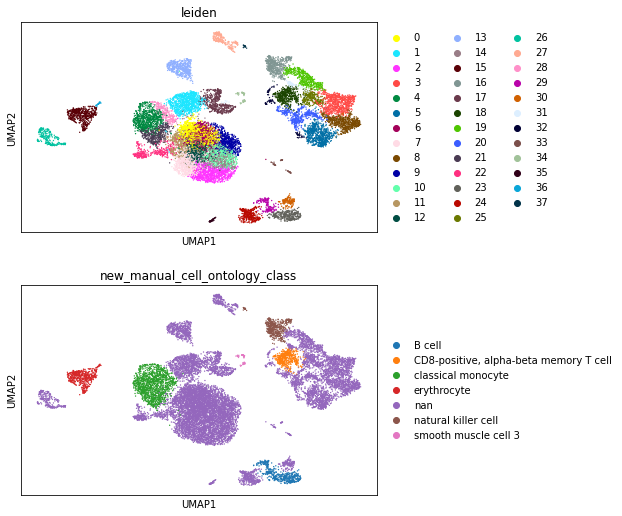

In [13]:
sc.pl.umap(
    organ_adata,
    color=["leiden", "new_manual_cell_ontology_class"],
    ncols=1,
)

In [14]:
organ_adata.obs.groupby(["leiden"]).agg(
    {"new_manual_cell_ontology_class": set, "Propagated.Annotation": set}
)

,new_manual_cell_ontology_class,Propagated.Annotation
leiden,,
0,{nan},"{neutrophil, non-classical monocyte, classical..."
1,{nan},"{neutrophil, non-classical monocyte, cell, den..."
2,{nan},"{neutrophil, B cell, non-classical monocyte, c..."
3,{nan},"{naive thymus-derived CD4-positive, alpha-beta..."
4,{classical monocyte},"{dendritic cell, human, neutrophil, non-classi..."
5,{nan},"{B cell, memory B cell, CD8-positive, alpha-be..."
6,{nan},"{neutrophil, non-classical monocyte, cell, den..."
7,{nan},"{neutrophil, B cell, non-classical monocyte, c..."
8,{nan},"{naive thymus-derived CD4-positive, alpha-beta..."


/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  if is_string_dtype(df[key]) and not is_categorical(df[key])


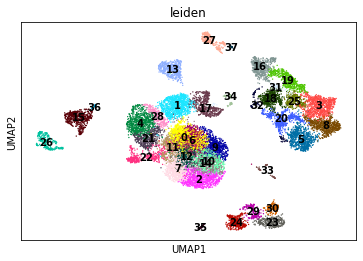

In [15]:
sc.pl.umap(organ_adata, color="leiden", legend_loc="on data")

# Sankey Diagram between cluster and compartment

In [16]:
from utils.colorDict import (
    donor_colors,
    method_colors,
    compartment_colors,
    tissue_colors,
)

In [17]:
from utils.plotting_utils import *
from utils.colorDict import compartment_colors

import plotly
import chart_studio.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

import plotly.io as pio

pio.renderers.default = "notebook"

init_notebook_mode(connected=True)

In [18]:
df = pd.DataFrame(columns=["celltype", "compartment", "count"])
for t in np.unique(organ_adata.obs["manual_cell_ontology_class"]):
    for c in np.unique(organ_adata.obs["compartment_pred_svm"]):
        x = np.sum(
            (organ_adata.obs["compartment_pred_svm"].astype(str) == c)
            & (organ_adata.obs["manual_cell_ontology_class"] == t)
        )
        df = df.append(
            pd.DataFrame([t, c, x], index=["celltype", "compartment", "count"]).T,
            ignore_index=True,
        )


fig = genSankey(
    df,
    cat_cols_color=[compartment_colors(), "#00A1E0"],
    cat_cols=["compartment", "celltype"],
    value_cols="count",
    title="celltype-compartment",
)
iplot(fig, validate=False)
plotly.offline.plot(
    fig, validate=False, filename="figures/celltype_sankey_%s" % organ + ".html"
)  # , output_type='div')

'figures/celltype_sankey_Blood.html'

# visualize compartment markers

In [19]:
compartment_markers = {
    "Epithelial": ["CDH1", "CLDN4", "EPCAM"],
    "Endothelial": ["CA4", "CDH5", "CLDN5", "PECAM1", "VWF"],
    "Stromal": ["BGN", "DCN", "COL1A2"],
    "Immune": ["LCP1", "PTPRC", "RAC2"],
}

In [20]:
for x in compartment_markers.keys():
    sc.tl.score_genes(organ_adata, compartment_markers[x], score_name="%s_score" % x)

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



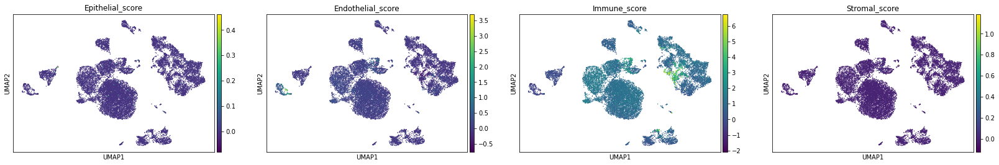

In [21]:
sc.pl.umap(
    organ_adata,
    color=["Epithelial_score", "Endothelial_score", "Immune_score", "Stromal_score"],
)

# Find markers for each cluster

In [22]:
sc.tl.rank_genes_groups(organ_adata, groupby="leiden", method="wilcoxon")

In [23]:
def FormatDE(res):
    groups = res['scores'].dtype.names
    df_res = {}
    for group in groups:
        df = pd.DataFrame([res['scores'][group],
                           res['logfoldchanges'][group],res['pvals_adj'][group]], 
                           columns=res['names'][group],
                           index=['wilcoxon_score','log fold change','adjusted pvalue'])
        df_res[group] = df
    return df_res


In [24]:
DE = FormatDE(organ_adata.uns["rank_genes_groups"])

### top positive marker genes

In [25]:
organ_cluster_genes = pd.DataFrame(organ_adata.uns['rank_genes_groups']['names'])
organ_cluster_genes.iloc[:20]


,0,1,2,3,4,5,6,7,8,9,...,28,29,30,31,32,33,34,35,36,37
0,CD163,MTCO1P12,S100A8,LTB,FCN1,GAS5,CST3,FOLR3,CCR7,LGALS1,...,S100A8,CD74,CD79A,SYNE2,IL32,SPINT2,CSF3R,CD79A,SLC4A1,CD7
1,RNASE1,CD163,S100A12,RPS29,CD14,CD69,RNASE1,IFITM2,TCF7,LMNA,...,CR1,MS4A1,MS4A1,GZMA,TRBC2,HINT1,AL512646.1,MS4A1,CA1,PRF1
2,MTND1P23,CTSB,FOLR3,IL7R,CLEC12A,RPS12,VSIG4,RBP7,BCL11B,S100A10,...,S100A9,MT-CYB,BANK1,CCL5,CD2,RPS23,ALPL,CD74,HBD,IFITM1
3,KLF10,METTL7A,RBP7,TRAC,SERPINA1,RPS26,CD163,NAMPT,RPS29,CAPG,...,MCEMP1,RPL21,CD79B,PARP8,CD3D,RPLP0,SLC25A37,PTPRCAP,HBM,CTSW
4,VSIG4,ADA2,IL1R2,IL32,TKT,IL7R,NPC2,S100A8,PRKCQ-AS1,LYZ,...,S100A12,EEF1A1P5,HLA-DPB1,IL7R,CD3G,RPS5,BASP1,BLK,AHSP,KLRD1
5,CTSB,FKBP5,PLBD1,BCL11B,ITGB2,RPS27A,CTSB,S100A12,RPS27,RNASE2,...,PADI4,MT-CO3,HLA-DPA1,ETS1,IFITM1,PEBP1,CXCR2,CD79B,GYPC,GNLY
6,HMOX1,KCTD12,AC020656.1,CD3D,LRP1,RPL10P9,HMOX1,IL1R2,LTB,ANXA2,...,CD36,RPL18AP3,RALGPS2,AKNA,LINC00861,RPL37,IL1R2,HLA-DPB1,HBA1,NKG7
7,CST3,IRAK3,S100A9,LDHB,TYROBP,LEPROTL1,YBX1,AC020656.1,LDHB,RBM3,...,METTL9,MALAT1,TNFRSF13C,ATM,CD3E,EEF1B2,IFITM2,IGHM,HBB,PTPRCAP
8,KLF9,MARCH1,SERPINB1,CD3E,JAML,RPL14,AIF1,CLEC4E,CD3E,ENO1,...,PLBD1,TMSB4XP8,HLA-DRA,RORA,GZMA,RPS21,MMP25,HLA-DQA2,HBA2,GZMB
9,MS4A6A,HMOX1,GCA,RPS27,CD36,RPL30,MS4A6A,AC020916.1,RPS21,S100A9,...,FCN1,RPL13AP5,CD74,LYAR,TRAC,HSP90AB1,LRG1,AL139020.1,PTMS,CLIC3


In [26]:
for x in DE.keys():
    print(x)
    display(DE[x].T[:20])

0


,wilcoxon_score,log fold change,adjusted pvalue
CD163,39.487671,2.926631,0.000000e+00
RNASE1,37.570492,3.492799,1.919690e-304
MTND1P23,36.068371,2.231287,1.394627e-280
KLF10,35.362854,2.305832,9.363780e-270
VSIG4,35.087055,2.945470,1.250453e-265
CTSB,34.205750,2.199889,1.948661e-252
HMOX1,33.561562,2.253646,5.134867e-243
CST3,33.055580,2.459433,9.517464e-236
KLF9,32.731918,2.105954,3.592178e-231
MS4A6A,32.228901,2.246545,4.091538e-224


1


,wilcoxon_score,log fold change,adjusted pvalue
MTCO1P12,35.569458,2.455515,2.447452e-272
CD163,31.362198,2.451413,1.952734e-211
CTSB,26.241938,1.809398,8.668261e-148
METTL7A,26.031181,1.673786,1.848310e-145
ADA2,25.698803,1.578844,8.870775e-142
FKBP5,25.003990,1.402556,3.256755e-134
KCTD12,24.957747,1.705585,9.416637e-134
IRAK3,24.136433,1.537933,4.694449e-125
MARCH1,23.822817,1.468572,8.149361e-122
HMOX1,23.554216,1.710445,3.716889e-119


2


,wilcoxon_score,log fold change,adjusted pvalue
S100A8,27.258785,3.598013,5.131817e-160
S100A12,26.857824,2.341051,2.235184e-155
FOLR3,23.611601,1.742189,5.389140e-120
RBP7,23.575022,1.661656,1.240623e-119
IL1R2,22.736116,1.864500,2.759940e-111
PLBD1,19.910975,1.326751,2.467209e-85
AC020656.1,18.710039,1.662768,2.595796e-75
S100A9,18.236849,2.999077,1.434675e-71
SERPINB1,17.895189,1.073295,6.757475e-69
GCA,17.811245,1.123902,2.985288e-68


3


,wilcoxon_score,log fold change,adjusted pvalue
LTB,41.197937,4.649414,0.000000e+00
RPS29,39.755852,2.354995,0.000000e+00
IL7R,39.455734,4.285452,0.000000e+00
TRAC,39.435856,3.623178,0.000000e+00
IL32,38.662514,3.949068,0.000000e+00
BCL11B,37.402435,3.522915,3.499935e-302
CD3D,37.144157,3.095073,4.581437e-298
LDHB,36.912216,2.450363,2.165594e-294
CD3E,36.866280,3.222235,1.049323e-293
RPS27,36.690609,2.122837,6.069325e-291


4


,wilcoxon_score,log fold change,adjusted pvalue
FCN1,43.856812,4.474844,0.0
CD14,43.216370,4.632235,0.0
CLEC12A,42.797668,4.026533,0.0
SERPINA1,42.657787,3.878228,0.0
TKT,41.941452,3.296006,0.0
ITGB2,41.705830,3.351371,0.0
LRP1,41.570011,3.497206,0.0
TYROBP,41.485641,3.403257,0.0
JAML,41.430729,3.737163,0.0
CD36,41.391403,3.940441,0.0


5


,wilcoxon_score,log fold change,adjusted pvalue
GAS5,35.804840,2.480493,5.466715e-276
CD69,34.871628,3.227880,5.892679e-262
RPS12,34.599964,1.809188,4.963609e-258
RPS26,34.519417,1.538438,6.036978e-257
IL7R,34.210266,3.558222,2.003123e-252
RPS27A,34.103600,1.694939,6.400575e-251
RPL10P9,33.981228,2.497744,3.548145e-249
LEPROTL1,33.731571,2.461016,1.465778e-245
RPL14,33.597748,1.723546,1.183576e-243
RPL30,33.380863,1.519776,1.529988e-240


6


,wilcoxon_score,log fold change,adjusted pvalue
CST3,33.065624,2.807563,5.461032e-235
RNASE1,32.484856,3.765686,5.136384e-227
VSIG4,32.071922,3.328737,2.131646e-221
CD163,31.439003,2.795185,8.732897e-213
NPC2,31.059410,2.212488,1.002563e-207
CTSB,30.229090,2.326902,9.640563e-197
HMOX1,29.836977,2.480276,1.089419e-191
YBX1,29.273609,1.561393,1.654605e-184
AIF1,28.878134,2.598876,1.469932e-179
MS4A6A,28.415886,2.341417,7.576577e-174


7


,wilcoxon_score,log fold change,adjusted pvalue
FOLR3,21.838821,1.879884,1.948299e-102
IFITM2,19.326025,1.116096,3.351209e-80
RBP7,19.088158,1.505415,2.959844e-78
NAMPT,19.075148,1.519291,3.737049e-78
S100A8,16.647072,2.963474,2.125852e-59
S100A12,16.532389,1.519820,1.402903e-58
IL1R2,16.519747,1.580155,1.711163e-58
AC020656.1,16.306765,1.646204,5.592625e-57
CLEC4E,15.984208,1.248895,1.020288e-54
AC020916.1,15.782124,1.470425,2.506839e-53


8


,wilcoxon_score,log fold change,adjusted pvalue
CCR7,35.359409,4.124050,4.231144e-269
TCF7,34.670082,3.627343,6.551737e-259
BCL11B,34.570118,3.752956,1.394727e-257
RPS29,34.052437,2.227883,5.497625e-250
PRKCQ-AS1,32.987118,3.263912,1.463472e-234
RPS27,32.250679,2.131460,3.376916e-224
LTB,31.643976,3.462528,7.718331e-216
LDHB,31.628874,2.283051,1.089528e-215
CD3E,31.548664,3.082375,1.223443e-214
RPS21,31.337563,1.747270,8.461059e-212


9


,wilcoxon_score,log fold change,adjusted pvalue
LGALS1,29.553749,2.694011,3.460219e-187
LMNA,29.058285,2.791692,3.559408e-181
S100A10,29.018694,2.153304,7.501880e-181
CAPG,28.962952,2.323365,2.837269e-180
LYZ,28.357447,3.607876,7.977032e-173
RNASE2,28.247019,2.452339,1.519416e-171
ANXA2,28.143362,2.182296,2.429936e-170
RBM3,28.013819,1.757521,8.115101e-169
ENO1,27.932434,1.727538,7.048909e-168
S100A9,27.343077,4.202182,7.684465e-161


10


,wilcoxon_score,log fold change,adjusted pvalue
S100A9,27.345150,4.214950,7.260425e-160
S100A8,26.400352,3.976532,3.995749e-149
S100A12,26.364922,2.851300,6.792763e-149
LGALS1,25.429010,2.421563,1.773645e-138
FOLR3,24.606375,2.281046,1.271029e-129
AC020656.1,24.081491,2.457127,3.833624e-124
LYZ,23.940981,3.289191,9.648092e-123
S100A10,23.378574,1.784248,5.195445e-117
GAPDH,23.347961,1.694907,9.455135e-117
SERPINB1,23.220608,1.733737,1.659939e-115


11


,wilcoxon_score,log fold change,adjusted pvalue
PPBP,35.311443,4.644156,2.307375e-268
NRGN,33.862446,3.139955,7.007090e-247
PF4,32.069798,3.899585,2.282087e-221
TUBB1,31.693750,4.096071,2.788139e-216
ITGA2B,31.186756,3.878723,1.896971e-209
TREML1,30.301329,3.779543,1.080349e-197
CAVIN2,29.512341,3.685671,1.681562e-187
GNG11,28.671541,3.531008,6.357766e-177
CLU,27.086678,2.385032,9.245010e-158
SPARC,26.836472,3.118303,7.143110e-155


12


,wilcoxon_score,log fold change,adjusted pvalue
FOLR3,24.177437,2.328813,2.262578e-124
CLEC4E,23.827724,2.075673,5.073903e-121
CST3,23.708336,2.343596,5.804907e-120
AIF1,23.571676,2.387424,1.107658e-118
MS4A6A,22.976637,2.139578,9.399617e-113
NPC2,22.535219,1.758267,1.839724e-108
VSIG4,22.455269,2.394548,9.559358e-108
C1orf162,22.436468,1.654733,1.276661e-107
CD163,22.213234,2.153611,1.673522e-105
LGALS3,22.131424,1.849861,9.273499e-105


13


,wilcoxon_score,log fold change,adjusted pvalue
GABARAP,33.767448,3.337431,3.490498e-245
NME2,30.069452,3.891645,1.022535e-194
ATP6V0C,27.558290,4.782585,1.151390e-163
ALDOA,27.009935,2.396161,3.325333e-157
IFITM3,22.054506,2.029401,1.106636e-104
IFI30,20.586697,2.080055,3.429419e-91
GNG5,17.968939,1.352165,1.761873e-69
AL138963.3,17.591322,4.981284,1.330838e-66
STAB1,16.625713,1.325024,1.817873e-59
CFP,15.727265,2.920531,3.347359e-53


14


,wilcoxon_score,log fold change,adjusted pvalue
S100A12,22.925400,2.535141,1.526698e-111
S100A8,22.105179,3.626403,8.295159e-104
S100A9,21.418463,3.677594,1.764301e-97
IL1R2,19.602074,2.288126,2.184842e-81
VCAN,19.519541,2.353427,8.819773e-81
AC020656.1,19.217554,2.085145,2.589469e-78
PLBD1,18.952208,1.704851,3.561112e-76
SERPINB1,18.776640,1.457672,8.629531e-75
MNDA,17.886322,1.837514,9.859840e-68
LGALS1,17.229874,1.880435,9.330652e-63


15


,wilcoxon_score,log fold change,adjusted pvalue
HBA2,38.985439,17.261843,0.000000e+00
HBB,38.982910,19.463827,0.000000e+00
HBA1,38.981419,16.362762,0.000000e+00
ALAS2,38.530228,13.089419,0.000000e+00
SLC25A37,38.069801,5.735702,0.000000e+00
SLC25A39,37.821556,5.652339,0.000000e+00
SNCA,37.287663,6.716731,2.686132e-301
GYPC,36.184235,4.162990,6.407958e-284
GLRX5,35.202724,4.553293,8.624201e-269
YBX3,34.949768,3.358125,5.911557e-265


16


,wilcoxon_score,log fold change,adjusted pvalue
GNLY,35.411419,6.821117,6.707081e-270
KLRD1,34.902901,5.422258,1.977524e-262
NKG7,34.351677,4.419070,2.609085e-254
GZMA,33.641685,4.991850,6.071379e-244
PRF1,33.588299,4.815875,2.927097e-243
GZMB,32.458946,5.066711,3.974093e-227
HOPX,31.821142,3.979105,2.776811e-218
KLRF1,31.618719,6.109037,1.502598e-215
CLIC3,31.347717,5.893721,6.836580e-212
CTSW,31.317598,3.757264,1.582451e-211


17


,wilcoxon_score,log fold change,adjusted pvalue
AL512646.1,35.270008,8.416716,9.969504e-268
MT-RNR2,32.658302,4.256081,1.798154e-229
MTRNR2L12,31.583685,6.645455,1.213684e-214
MT-ATP8,30.438505,5.118714,2.502627e-199
RPL13P12,30.215036,5.127155,1.769888e-196
SLC11A1,29.017939,5.382127,3.834115e-181
FTH1P20,28.825045,6.560680,8.759143e-179
FTLP3,28.724005,6.083071,1.408124e-177
RPS28P7,28.685474,6.213852,3.787976e-177
AC114801.3,28.616837,9.000257,2.441984e-176


18


,wilcoxon_score,log fold change,adjusted pvalue
CCL5,32.373989,4.780895,3.754635e-225
GZMA,30.212877,4.503840,4.723127e-196
LYAR,29.808092,3.478054,6.021768e-191
CST7,26.900827,3.480112,3.161065e-155
IL7R,25.586803,3.530512,1.799383e-140
FGFBP2,25.537802,4.232234,5.520202e-140
GNLY,25.177973,4.663431,4.110673e-136
CD3D,24.304983,2.675513,6.414670e-127
CXCR4,24.262449,2.445679,1.692103e-126
PPP2R5C,23.504335,2.029106,8.672533e-119


19


,wilcoxon_score,log fold change,adjusted pvalue
NKG7,33.784687,4.712910,1.948927e-245
CST7,32.875763,4.154611,1.436682e-232
GZMA,32.679649,4.874043,5.964810e-230
PRF1,32.243244,4.884644,6.438797e-224
CCL5,31.464931,4.607419,3.088424e-213
CTSW,30.721708,3.772945,2.865144e-203
GZMM,30.378990,3.796167,8.753773e-199
KLRD1,30.041969,4.967382,2.045648e-194
CCL4,29.655018,4.624892,1.911383e-189
GNLY,29.501369,6.123415,1.627686e-187


20


,wilcoxon_score,log fold change,adjusted pvalue
EEF1A1P5,35.556763,9.467222,3.845406e-272
EEF1A1,35.463161,6.129402,5.352082e-271
B2M,35.439735,6.700628,8.192277e-271
EEF1A1P6,35.344082,8.019856,1.819263e-269
MT-CO3,35.330788,5.803949,2.329037e-269
MT-CYB,35.254147,6.502016,2.908232e-268
RPL13AP5,35.205582,8.806421,1.381448e-267
MALAT1,35.161030,6.399279,5.802927e-267
MT-CO1,35.138130,6.095044,1.154341e-266
RPS27,35.130653,5.660850,1.237157e-266


21


,wilcoxon_score,log fold change,adjusted pvalue
VNN2,30.583292,4.300128,1.201892e-200
RGS2,29.663801,3.679601,6.626784e-189
FPR1,29.225224,3.141076,1.819725e-183
CSF3R,28.587420,3.028139,1.417573e-175
NAMPT,28.309013,3.205546,3.151743e-172
JAML,28.196325,3.090248,6.364710e-171
CD14,27.824337,3.462300,1.852315e-166
SERPINA1,27.785702,3.047881,4.751871e-166
CLEC12A,27.684423,3.099982,7.034118e-165
CD93,27.461695,2.969905,2.965532e-162


22


,wilcoxon_score,log fold change,adjusted pvalue
FCGR3A,30.340208,5.174642,1.991552e-197
LST1,29.656485,3.802368,8.234823e-189
MS4A7,28.384733,4.076885,6.124276e-173
SMIM25,28.136858,4.347033,5.107672e-170
AIF1,27.029318,3.169602,7.872727e-157
TCF7L2,26.824574,5.186278,1.638970e-154
IFITM3,26.729994,3.366480,1.774371e-153
HLA-DPA1,26.353886,3.365827,3.408781e-149
FCER1G,25.640446,2.991710,3.534717e-141
IFITM2,25.282896,2.318020,2.900156e-137


23


,wilcoxon_score,log fold change,adjusted pvalue
IGHM,30.910368,7.347086,5.102097e-205
CD79A,30.240427,5.747124,2.052107e-196
IGHD,29.978863,5.941543,3.632379e-193
AL139020.1,29.932631,6.173992,1.089876e-192
MS4A1,29.743752,5.318152,2.459394e-190
CD79B,29.279827,4.523011,1.838549e-184
LINC00926,28.186996,5.243784,7.098827e-171
HLA-DPB1,26.705845,3.139178,2.633343e-153
CD37,26.285124,2.197606,1.284843e-148
BANK1,25.976913,4.362826,3.797717e-145


24


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,29.729692,5.485103,1.868825e-189
IGHM,28.096695,5.756444,3.164377e-169
TNFRSF13C,27.906740,5.257071,4.336968e-167
IGHD,27.893766,5.582693,4.673586e-167
MS4A1,27.810595,4.659871,3.802539e-166
JUND,27.059149,2.593497,2.507025e-157
CXCR4,26.431559,2.795282,4.375365e-150
BTG1,26.244411,2.380424,4.873522e-148
HLA-DQA1,25.936394,5.279233,1.385810e-144
AL139020.1,24.399385,4.407473,6.387745e-128


25


,wilcoxon_score,log fold change,adjusted pvalue
IL32,26.904604,5.146455,1.142109e-154
CD3D,26.591986,4.345144,2.473487e-151
TRAC,26.225630,4.313372,2.660897e-147
CD2,25.641380,4.054802,7.764725e-141
CD3G,25.088818,3.817504,7.755745e-135
LCK,24.991186,3.713704,7.479204e-134
CD27,24.066217,4.363343,4.749211e-124
CD3E,23.839436,3.423975,9.590531e-122
ARL4C,23.693548,3.269966,2.748860e-120
ISG20,23.559525,3.199911,5.902829e-119


26


,wilcoxon_score,log fold change,adjusted pvalue
TUBB1,27.290323,8.418622,3.253088e-159
PF4,27.140039,8.701715,9.770261e-158
PPBP,27.071737,9.187840,4.158827e-157
ITGA2B,26.863455,7.929338,8.644427e-155
CAVIN2,26.740820,7.915129,1.859097e-153
GP9,26.538414,8.668672,2.057167e-151
GNG11,26.271833,7.478831,1.247177e-148
MPIG6B,26.239954,7.627987,2.739694e-148
TREML1,26.030092,7.836046,4.589948e-146
SPARC,25.720293,7.045558,8.327876e-143


27


,wilcoxon_score,log fold change,adjusted pvalue
IFITM1,22.964565,3.432686,1.551253e-112
RPS26,21.011459,1.605280,3.033410e-94
PTPRCAP,20.896643,8.149192,2.942628e-93
CD3E,20.082809,3.021572,3.838534e-86
IL32,18.985144,3.003455,5.551378e-77
IL7R,17.429953,2.857881,7.379307e-65
NME2,15.923387,3.032465,4.011598e-54
LCK,14.363076,1.746608,3.904995e-44
CD3D,14.282526,1.657652,1.208427e-43
C12orf57,14.223718,1.698695,2.745469e-43


28


,wilcoxon_score,log fold change,adjusted pvalue
S100A8,25.302393,5.614527,1.769814e-136
CR1,24.727949,4.127456,1.576031e-130
S100A9,24.661385,5.561632,5.451643e-130
MCEMP1,24.541441,4.381956,7.856332e-129
S100A12,24.512148,4.662790,1.290735e-128
PADI4,24.379810,5.067979,2.747954e-127
CD36,24.030949,3.957138,1.110739e-123
METTL9,23.884886,3.001832,3.058948e-122
PLBD1,23.882315,3.788939,3.058948e-122
FCN1,23.796331,4.009517,2.145797e-121


29


,wilcoxon_score,log fold change,adjusted pvalue
CD74,21.814266,10.362071,1.000044e-100
MS4A1,20.558310,11.675036,1.908986e-89
MT-CYB,20.308777,5.602602,2.110503e-87
RPL21,20.209345,4.822600,1.012576e-86
EEF1A1P5,20.206398,6.983225,1.012576e-86
MT-CO3,20.180037,4.969500,1.382560e-86
RPL18AP3,20.174385,6.262291,1.382560e-86
MALAT1,20.104635,5.325690,4.946073e-86
TMSB4XP8,19.996006,7.882371,3.902711e-85
RPL13AP5,19.963106,6.851603,6.788656e-85


30


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,19.523645,5.985494,4.069511e-80
MS4A1,19.359646,5.986342,4.975759e-79
BANK1,19.056519,5.689249,1.138303e-76
CD79B,18.567102,4.599162,8.730113e-73
HLA-DPB1,18.301937,3.887632,9.402532e-71
HLA-DPA1,18.080284,3.635020,4.471475e-69
RALGPS2,18.038065,4.957883,8.234528e-69
TNFRSF13C,17.575127,4.891456,2.811321e-65
HLA-DRA,17.382404,3.635827,7.335985e-64
CD74,17.294542,3.234350,3.044289e-63


31


,wilcoxon_score,log fold change,adjusted pvalue
SYNE2,10.277341,2.799534,1.140965e-21
GZMA,10.100120,3.088738,5.698500e-21
CCL5,10.083555,2.851439,6.629857e-21
PARP8,9.987827,2.212058,1.636187e-20
IL7R,9.692630,3.000176,2.271215e-19
ETS1,9.375586,2.110228,4.009743e-18
AKNA,9.186818,1.814819,2.108027e-17
ATM,9.135377,1.650592,3.307849e-17
RORA,9.105542,2.552312,4.259614e-17
LYAR,8.978580,2.253136,1.271426e-16


32


,wilcoxon_score,log fold change,adjusted pvalue
IL32,7.703350,2.946165,2.021482e-12
TRBC2,6.900404,2.909834,5.020862e-10
CD2,6.614063,2.432784,3.100308e-09
CD3D,5.983433,2.337958,1.321903e-07
CD3G,5.885323,1.834181,2.308761e-07
IFITM1,5.586246,2.978860,1.172397e-06
LINC00861,5.552919,2.768658,1.401594e-06
CD3E,5.488889,1.957848,1.963000e-06
GZMA,5.439670,1.828262,2.528115e-06
TRAC,5.370163,2.460878,3.612344e-06


33


,wilcoxon_score,log fold change,adjusted pvalue
SPINT2,11.807818,3.903494,2.093835e-27
HINT1,11.476568,3.123644,5.092586e-26
RPS23,11.409578,2.529280,7.349707e-26
RPLP0,11.239395,2.801479,3.843711e-25
RPS5,11.210874,2.750554,4.245881e-25
PEBP1,11.070323,3.329010,1.565800e-24
RPL37,11.064652,2.088185,1.565800e-24
EEF1B2,10.954945,2.756302,4.502815e-24
RPS21,10.946797,2.278358,4.502815e-24
HSP90AB1,10.908919,3.094609,6.151390e-24


34


,wilcoxon_score,log fold change,adjusted pvalue
CSF3R,5.980096,2.868347,1.589393e-07
AL512646.1,5.924696,3.340486,2.195343e-07
ALPL,5.216921,6.870603,9.596544e-06
SLC25A37,4.908710,3.102868,4.334983e-05
BASP1,4.326767,3.327615,5.508864e-04
CXCR2,3.758929,4.966311,4.862399e-03
IL1R2,3.618748,2.691634,7.878558e-03
IFITM2,3.520751,1.846569,1.103369e-02
MMP25,3.340335,4.154497,2.000851e-02
LRG1,3.275399,3.569511,2.453215e-02


35


,wilcoxon_score,log fold change,adjusted pvalue
CD79A,10.752118,5.180907,3.409512e-22
MS4A1,10.608280,5.051199,8.027558e-22
CD74,10.034893,3.244315,2.101172e-19
PTPRCAP,9.910903,6.854156,3.882376e-19
BLK,9.889650,4.856899,3.882376e-19
CD79B,9.203419,3.375921,1.275784e-16
HLA-DPB1,8.934776,2.651711,1.143767e-15
IGHM,8.745622,4.249303,5.021847e-15
HLA-DQA2,8.729335,5.450552,5.585558e-15
AL139020.1,8.724640,4.768618,5.614263e-15


36


,wilcoxon_score,log fold change,adjusted pvalue
SLC4A1,7.907405,9.300691,7.712268e-11
CA1,7.885917,11.325341,7.712268e-11
HBD,7.800336,9.221157,7.712268e-11
HBM,7.770603,8.286543,7.712268e-11
AHSP,7.768991,8.673039,7.712268e-11
GYPC,7.514376,4.754953,7.712268e-11
HBA1,7.511199,11.029135,7.712268e-11
HBB,7.503958,13.905729,7.712268e-11
HBA2,7.491532,10.285990,7.712268e-11
PTMS,7.430173,6.278543,8.840791e-11


37


,wilcoxon_score,log fold change,adjusted pvalue
CD7,6.444959,4.409804,0.000004
PRF1,6.411302,4.801829,0.000004
IFITM1,6.292377,4.378252,0.000005
CTSW,6.279588,3.908320,0.000005
KLRD1,6.130216,4.444122,0.000007
GNLY,6.116250,5.549496,0.000007
NKG7,6.108223,4.051152,0.000007
PTPRCAP,5.956631,6.644912,0.000015
GZMB,5.902987,4.448015,0.000016
CLIC3,5.773842,5.142944,0.000025


### for cluster 0 plot the top marker genes

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



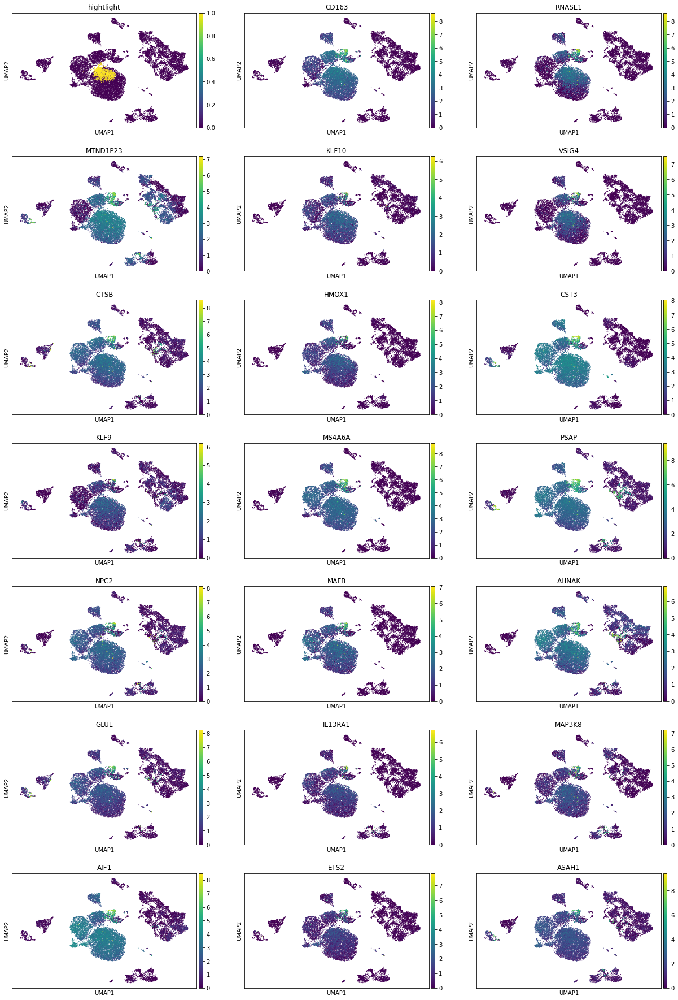

In [27]:
topgenes = list(DE["0"].T[:20].index)
organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == "0"
sc.pl.umap(
    organ_adata,
    color=["hightlight"] + topgenes,
    ncols=3,
)

You can do this for other clusters as well. Here I plot the top 5 genes for all other clusters

0


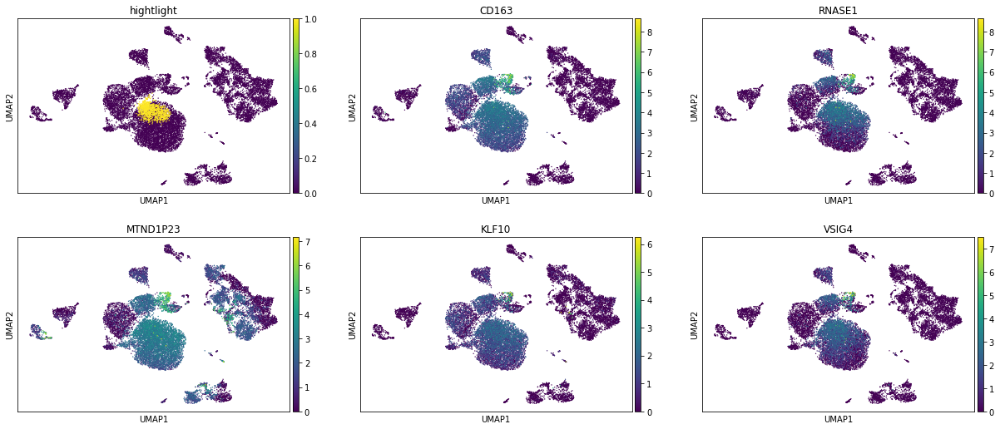

1


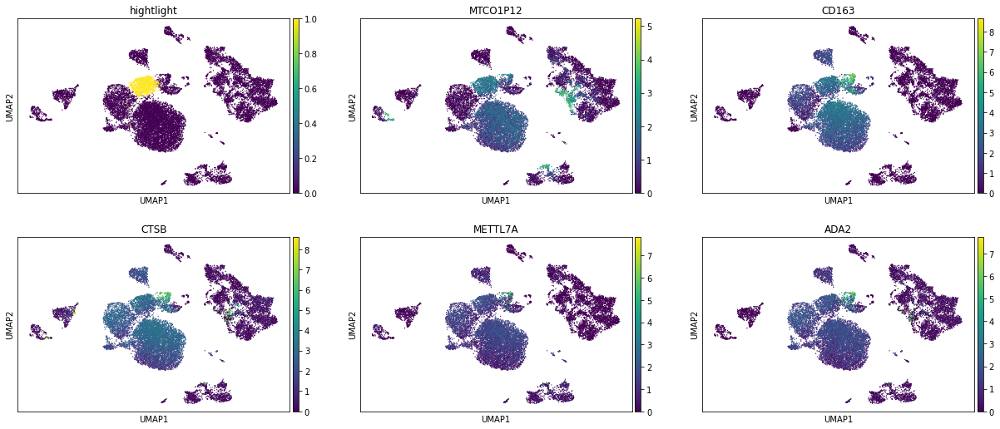

2


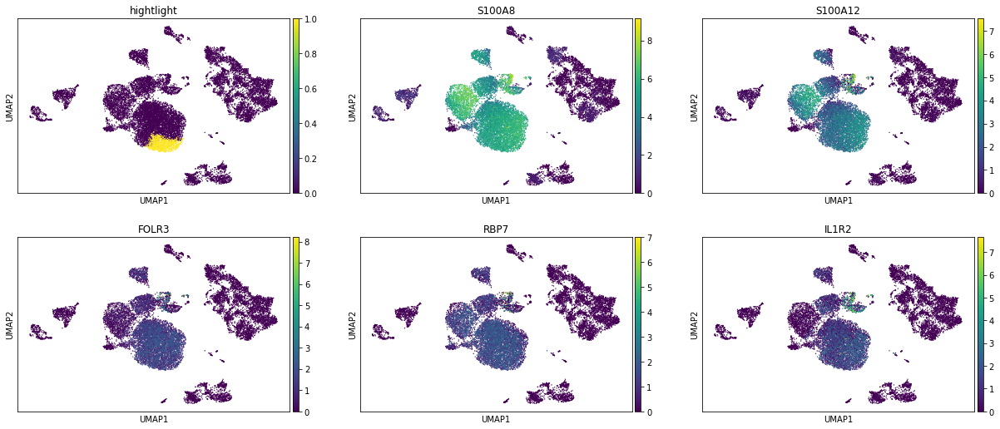

3


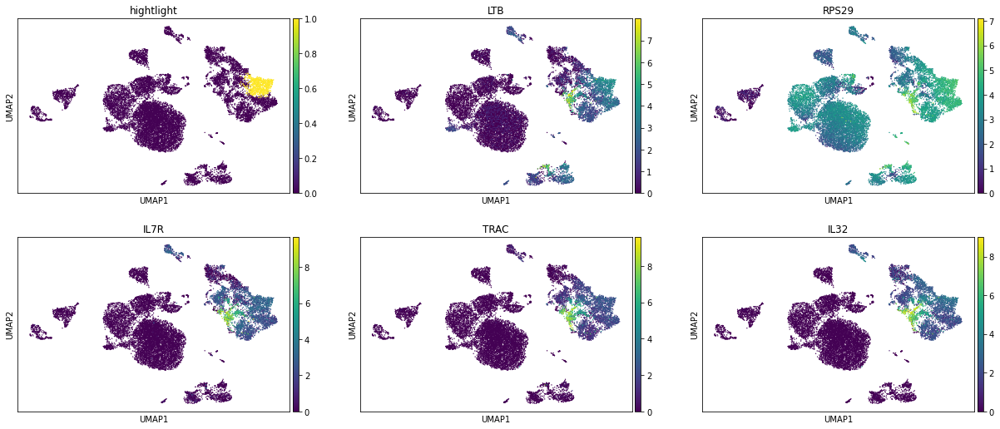

4


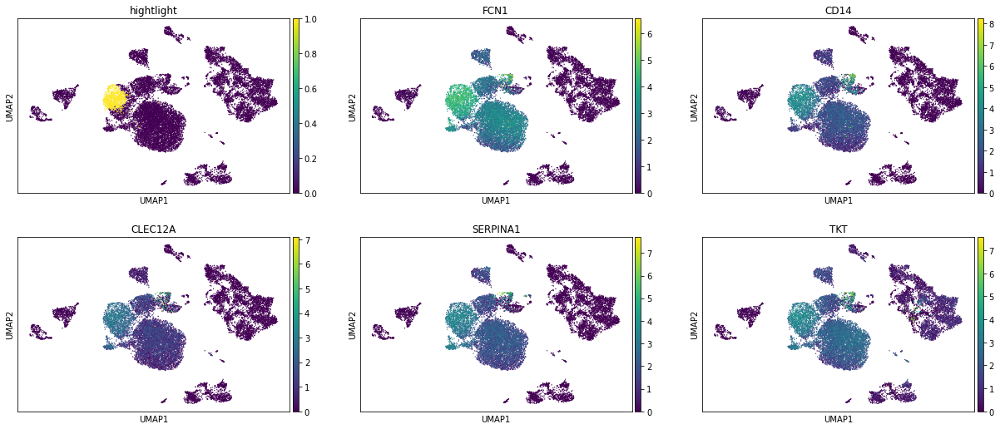

5


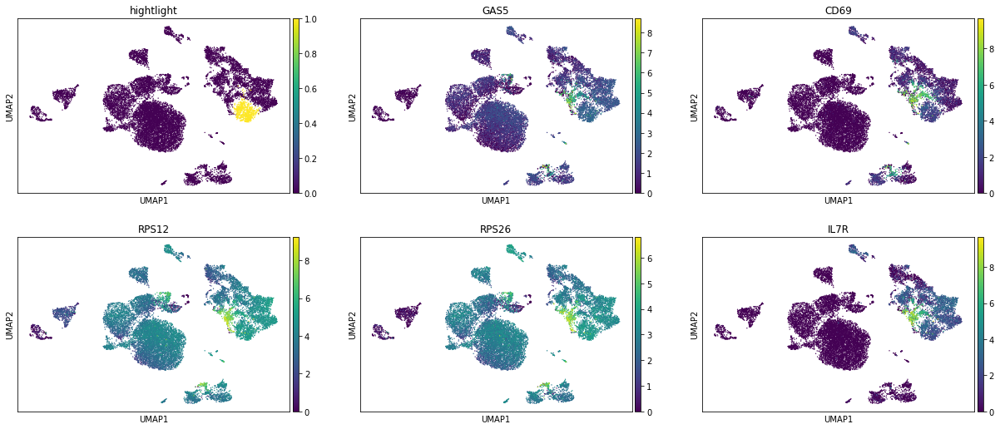

6


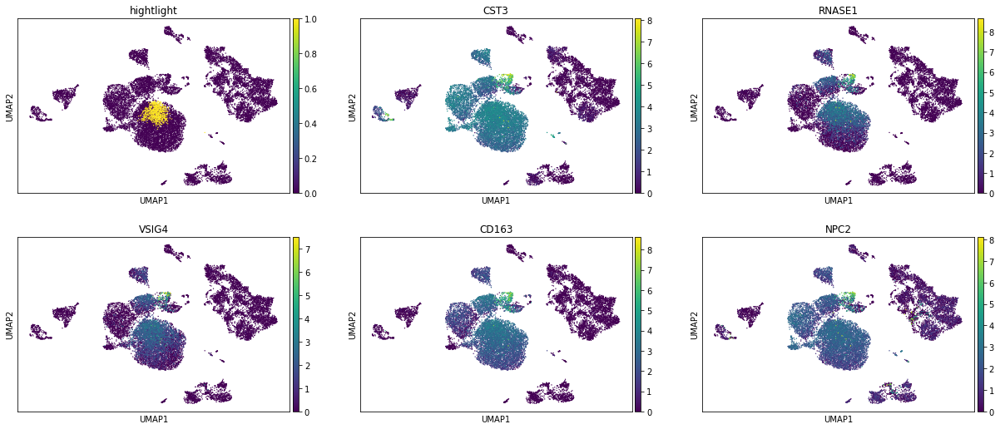

7


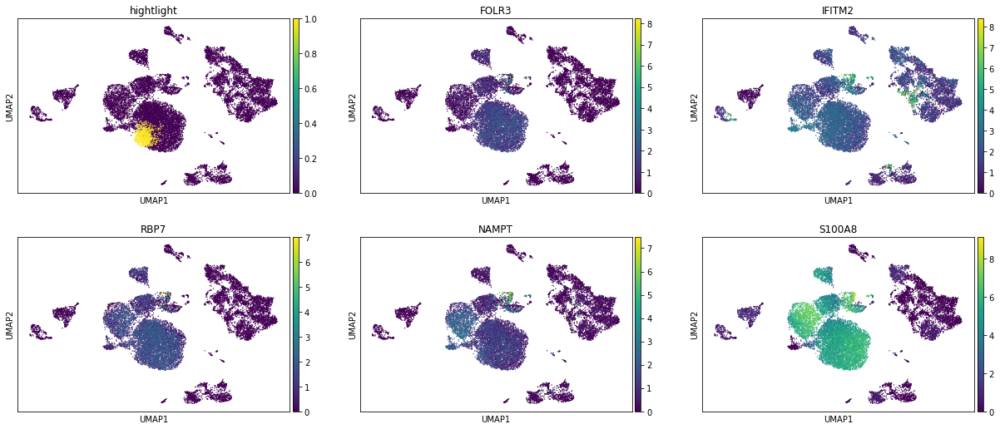

8


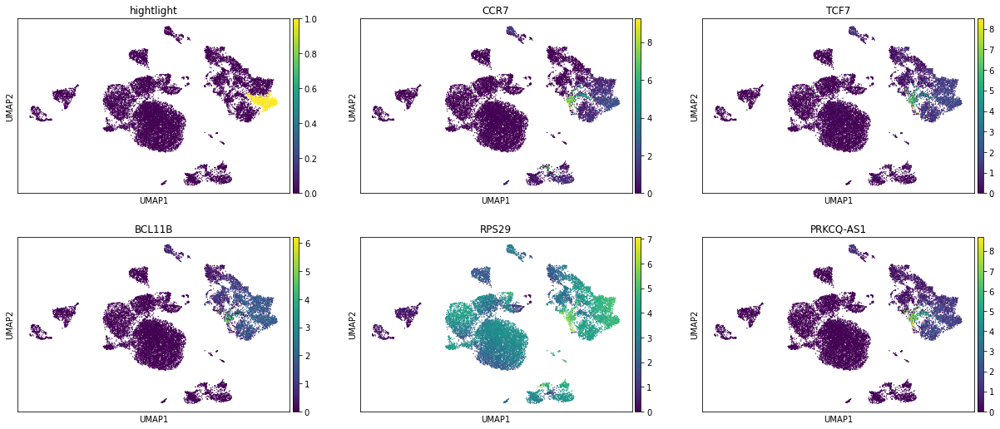

9


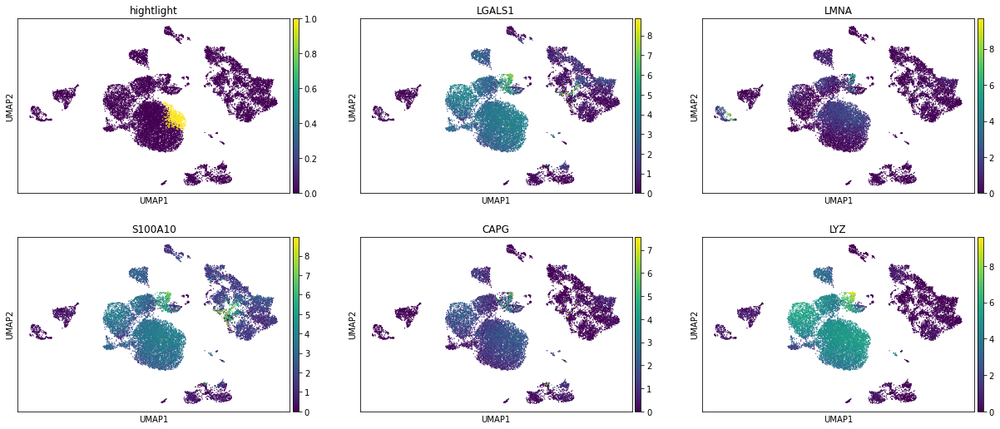

10


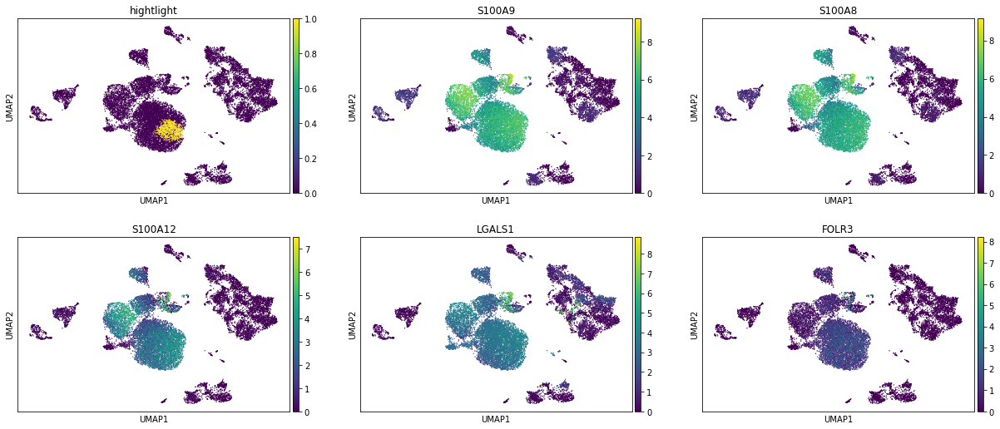

11


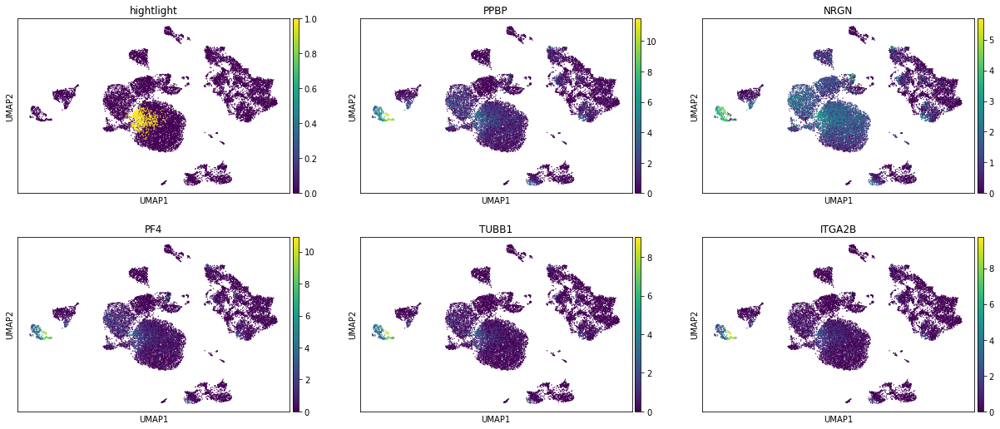

12


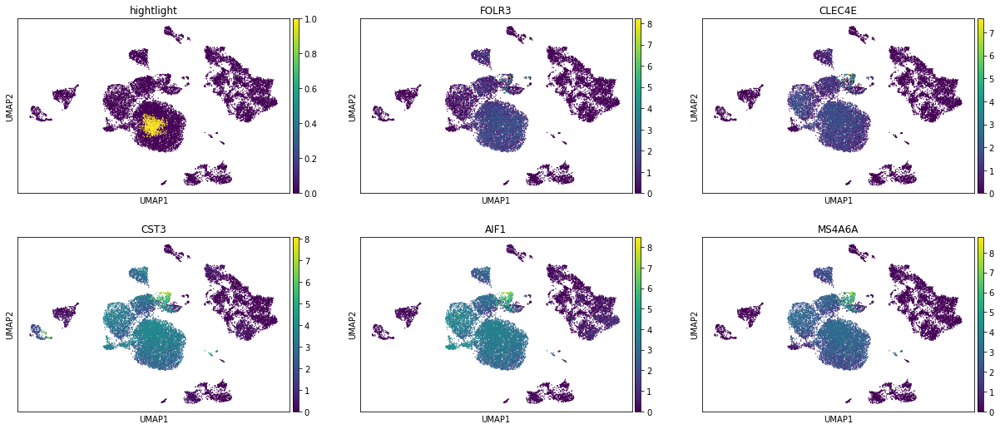

13


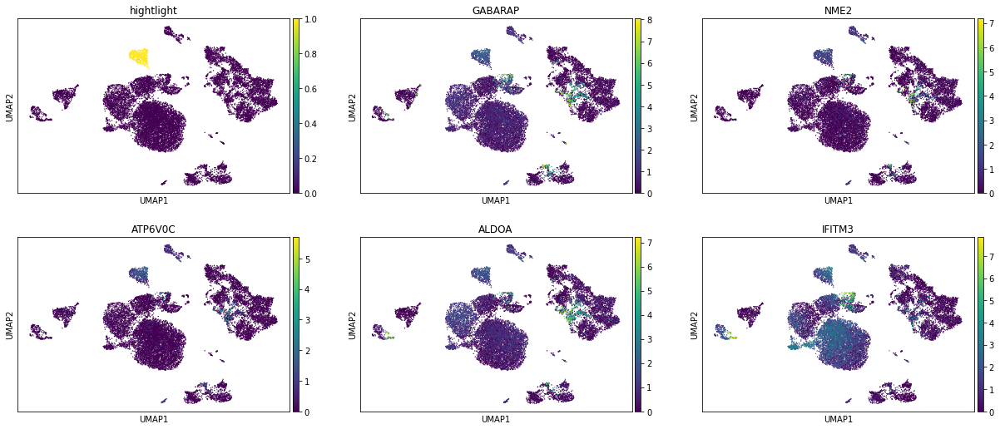

14


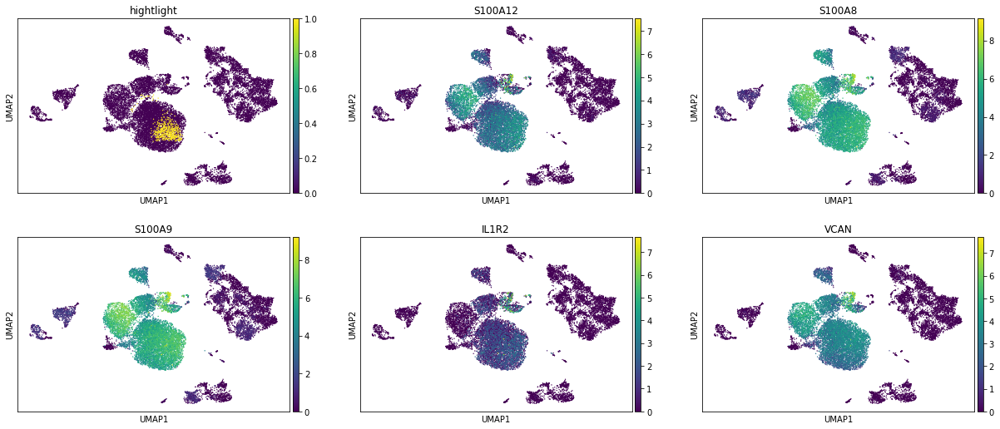

15


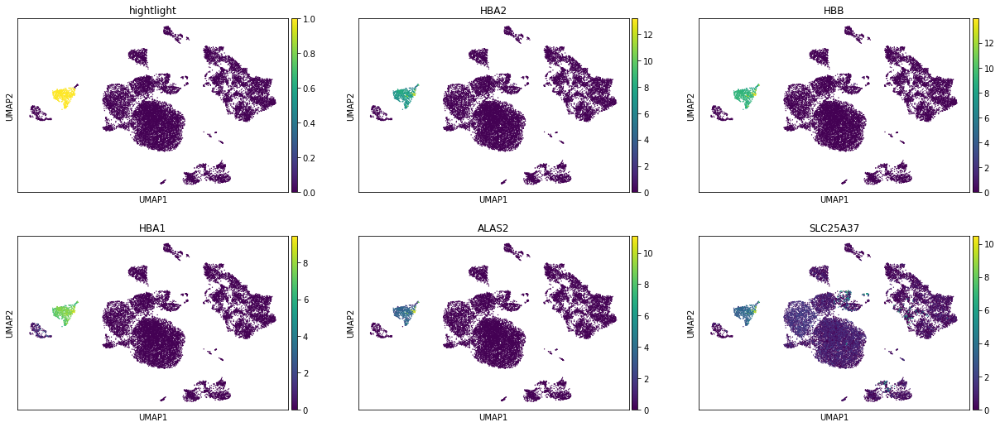

16


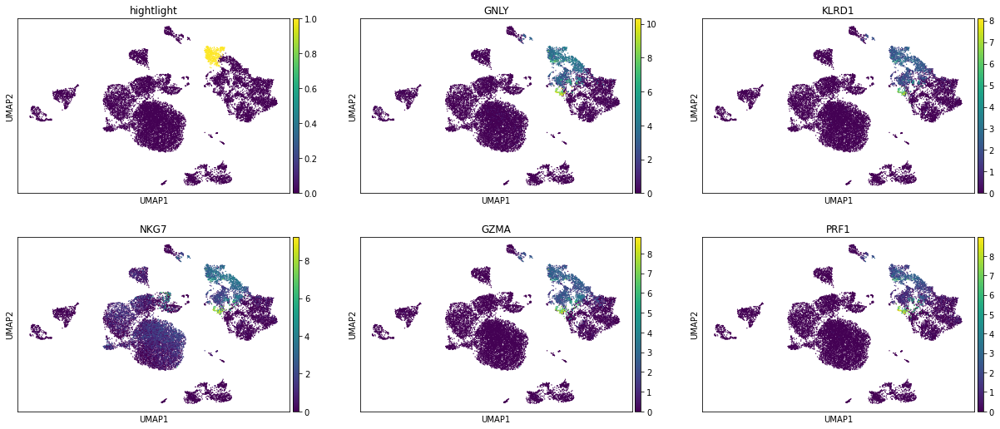

17


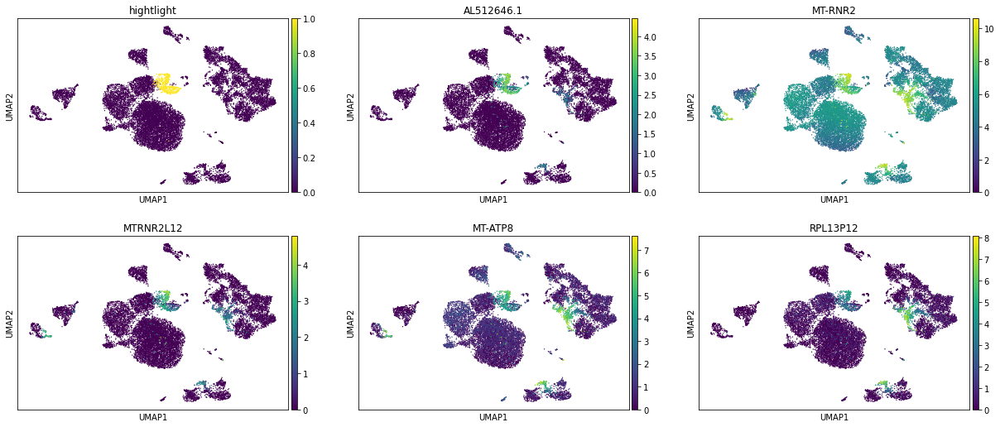

18


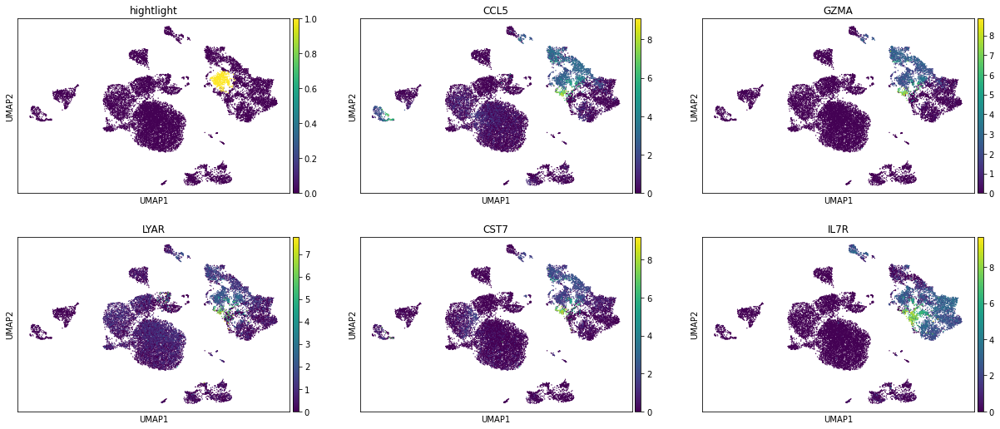

19


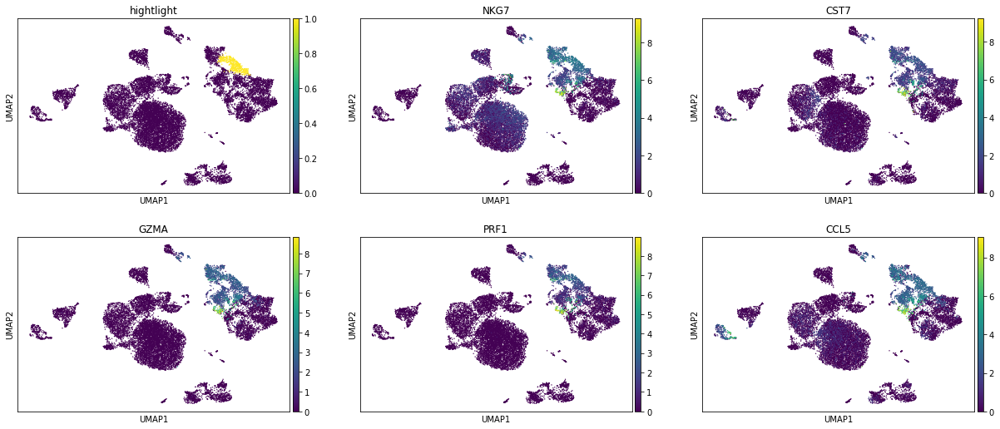

20


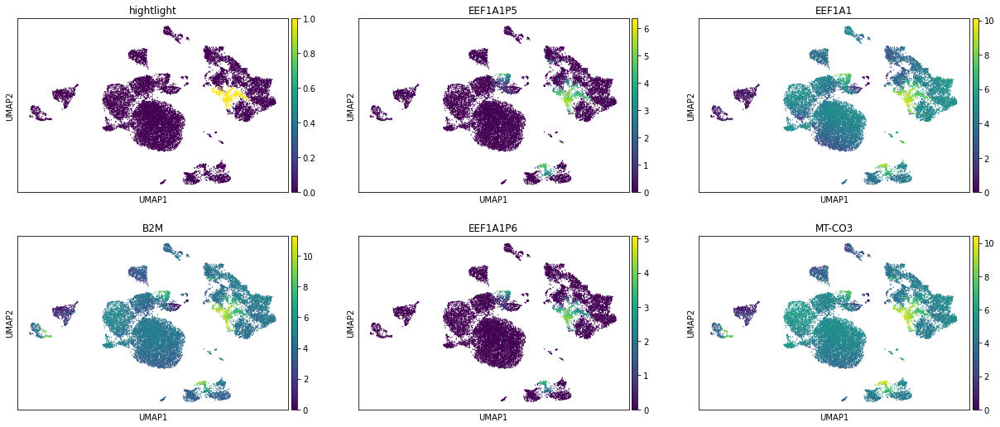

21


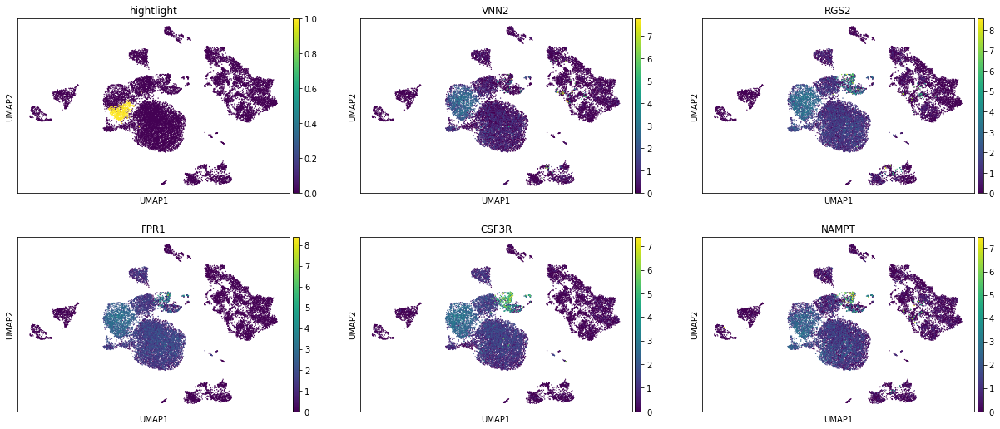

22


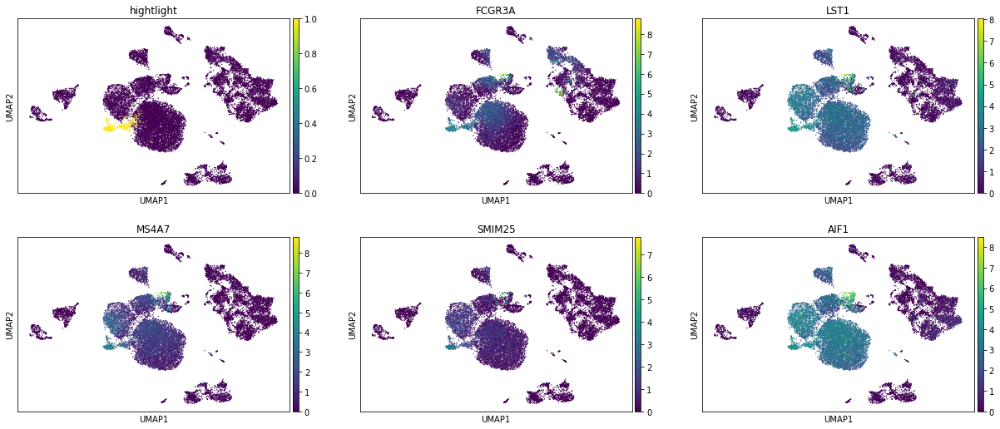

23


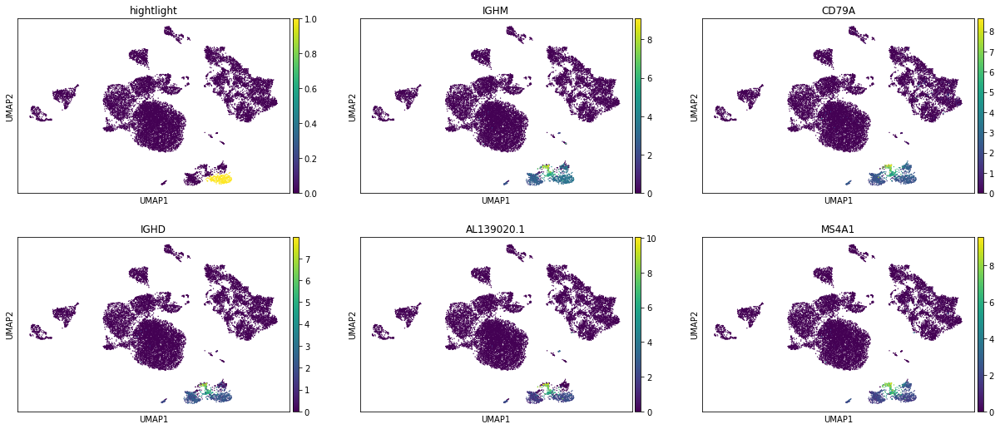

24


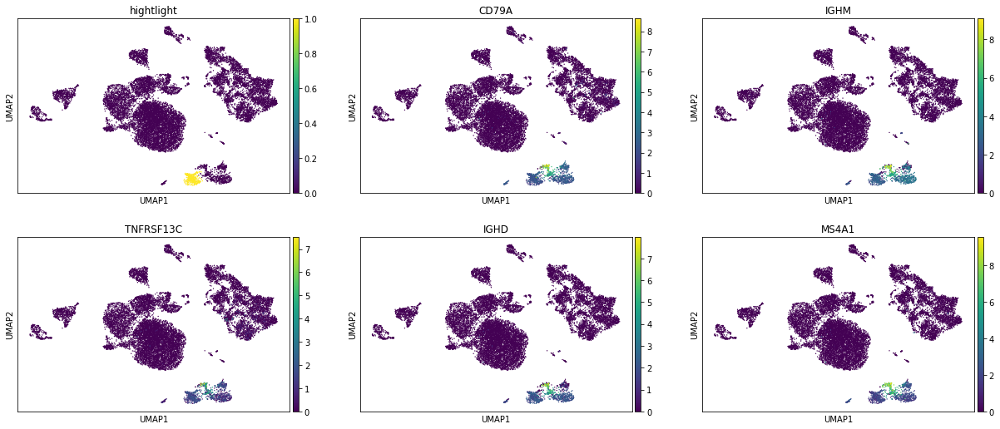

25


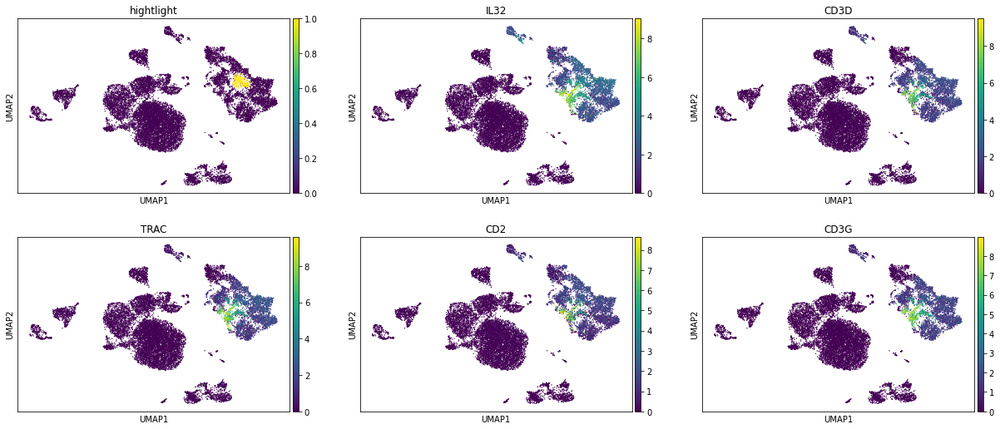

26


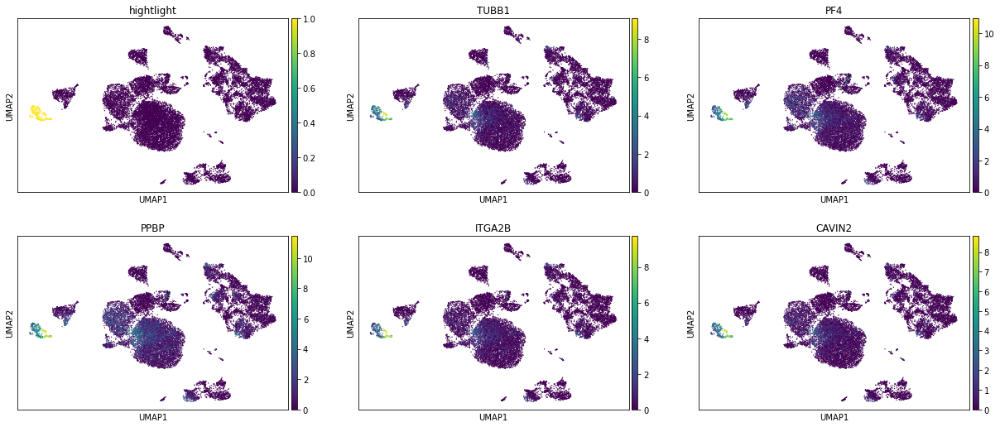

27


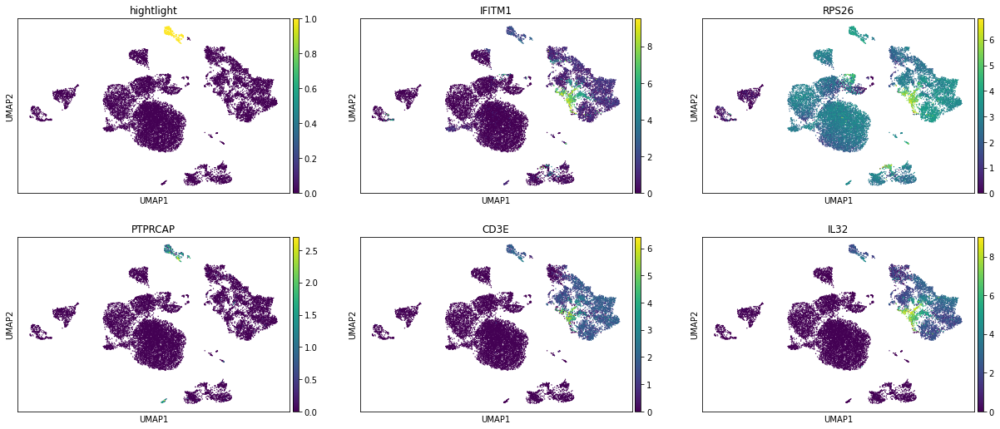

28


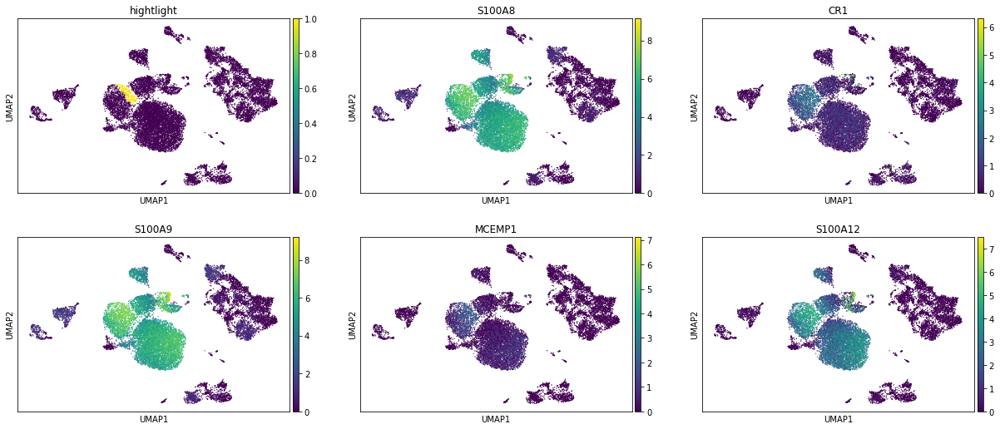

29


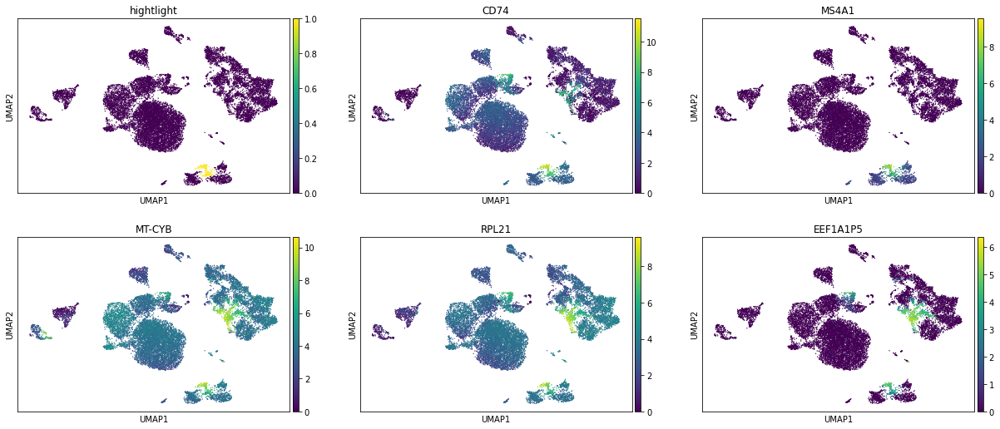

30


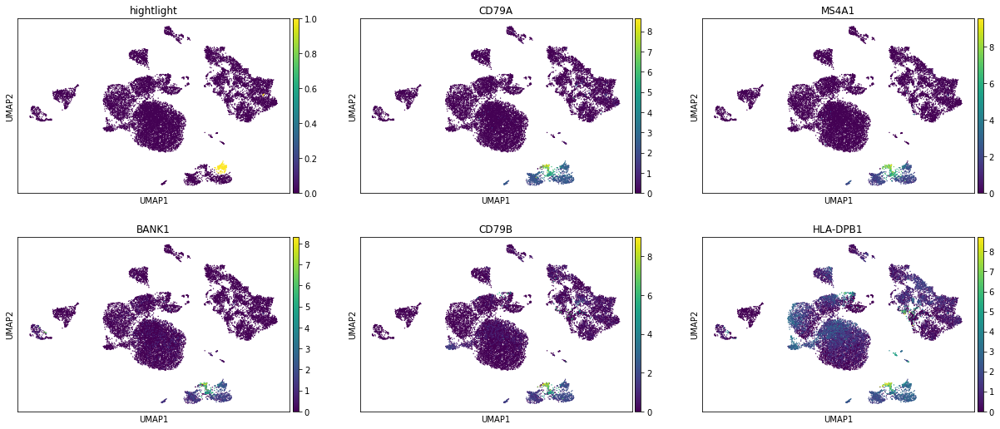

31


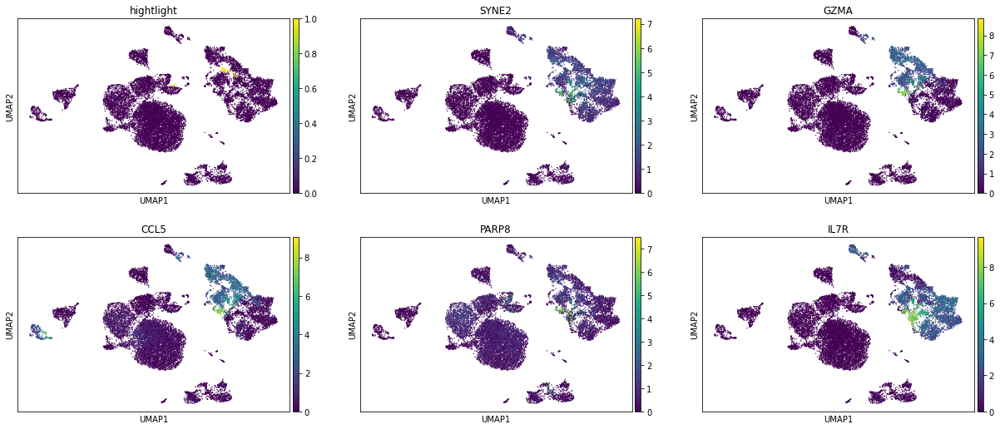

32


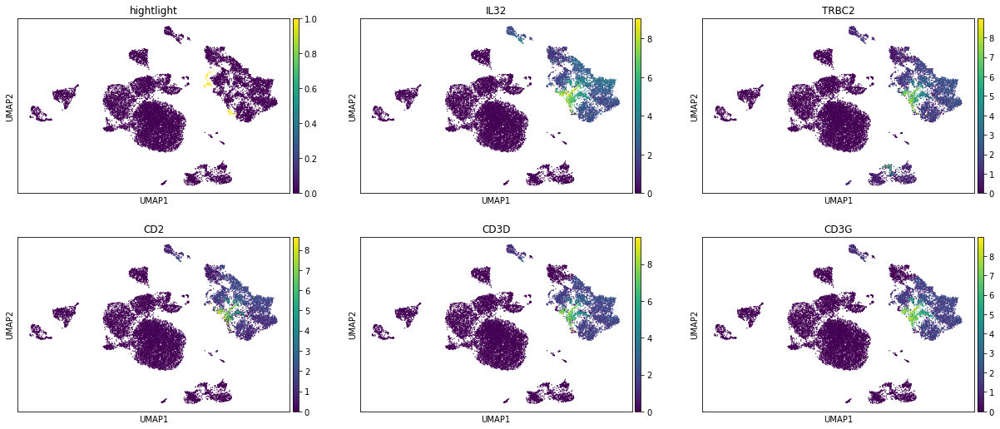

33


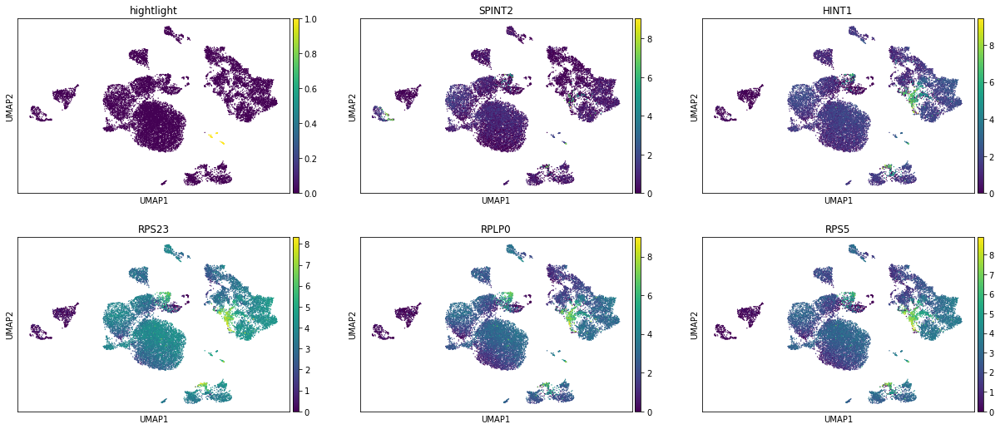

34


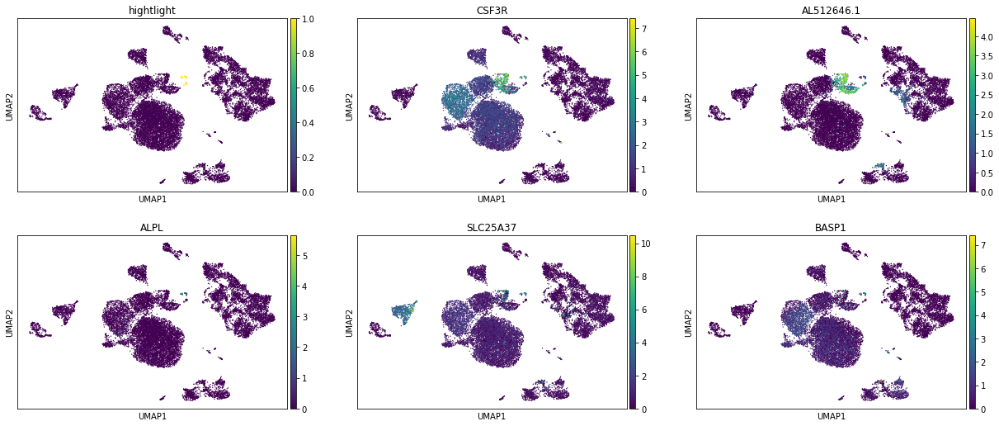

35


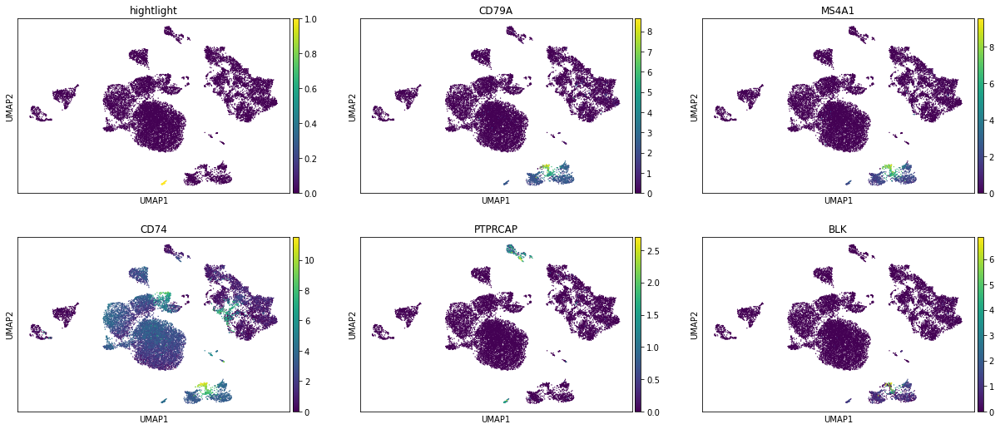

36


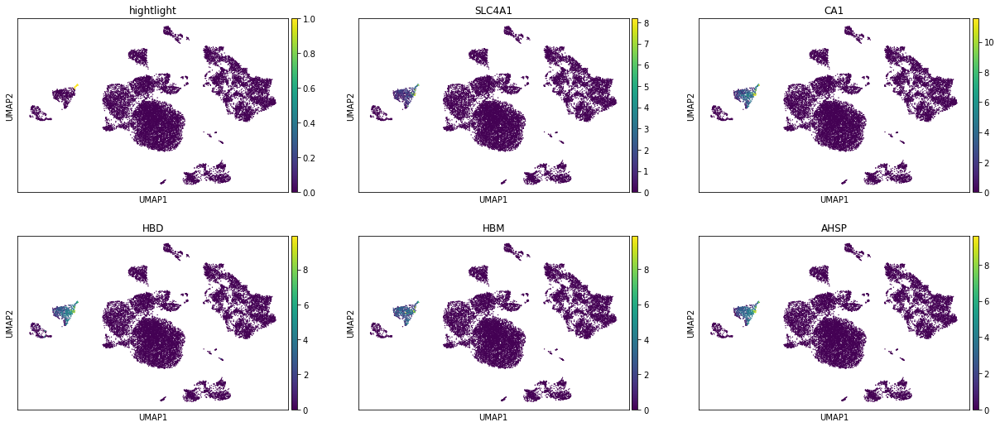

37


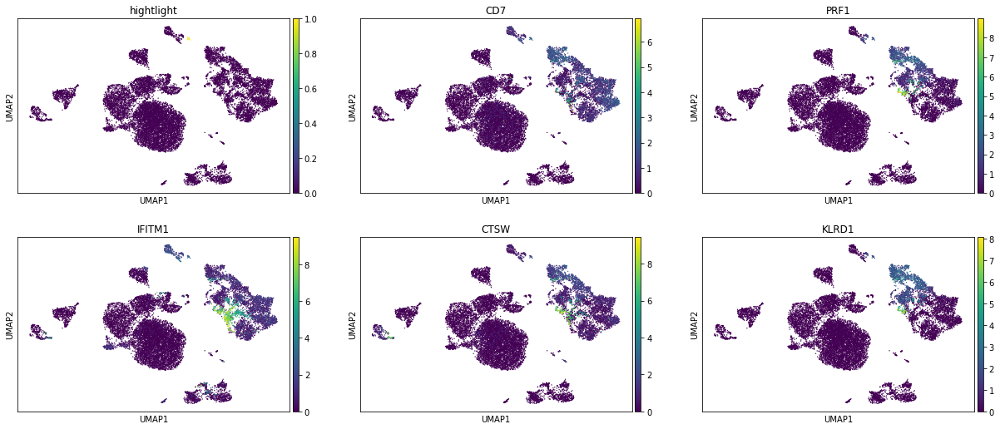

In [28]:
for x in DE.keys():
    print(x)
    topgenes = list(DE[x].T[:5].index)
    organ_adata.obs["hightlight"] = organ_adata.obs["leiden"] == x
    sc.pl.umap(
        organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

### The extended DE list can be queried by 

In [29]:
DE["0"].T

,wilcoxon_score,log fold change,adjusted pvalue
CD163,39.487671,2.926631,0.000000e+00
RNASE1,37.570492,3.492799,1.919690e-304
MTND1P23,36.068371,2.231287,1.394627e-280
KLF10,35.362854,2.305832,9.363780e-270
VSIG4,35.087055,2.945470,1.250453e-265
...,...,...,...
TRBC2,-13.965635,-8.260161,1.783343e-42
PCED1B-AS1,-14.465833,-4.390694,1.516903e-45
IL32,-14.693916,-10.559610,5.535124e-47
ETS1,-14.787635,-4.899960,1.402301e-47


# read in cell ontology 

In [30]:
import obonet

ont_dir = "/data/yosef2/users/chenling/TabulaSapiensData/ontology/"
obo = ont_dir + "cl.obo.txt"
f = open(obo, "r")
co = obonet.read_obo(f)
f.close()

celltype_dict = {}
for x in co.nodes:
    celltype_dict[co.nodes[x]['name']] = x



You can look up all T cell by typing celltype_dict['T'] and using tab complete  

In [31]:
celltype_dict["T cell"]

'CL:0000084'

You can also look at the names of all subsets of T cell that contains 'CD4' in their names

In [32]:
import networkx as nx


def PrintChildren(co, parent, pattern=""):
    all_children = [x for x in nx.ancestors(co, celltype_dict[parent])]
    return [co.nodes[x]["name"] for x in all_children if pattern in co.nodes[x]["name"]]


PrintChildren(co, "T cell", "CD4")

['CD4-negative, CD8-negative type I NK T cell secreting interleukin-4',
 'CD4-positive, alpha-beta thymocyte',
 'CD4-positive, alpha-beta cytotoxic T cell',
 'CD24-positive, CD4 single-positive thymocyte',
 'effector memory CD4-positive, alpha-beta T cell',
 'CD4-positive, alpha-beta memory T cell',
 'mature CD4 single-positive thymocyte',
 'CD4-negative, CD8-negative type I NK T cell secreting interferon-gamma',
 'CD4-positive helper T cell',
 'CD4-positive type I NK T cell',
 'CD4-positive, CXCR3-negative, CCR6-negative, alpha-beta T cell',
 'CD4-positive, CD8-intermediate double-positive thymocyte',
 'CD4-positive, CD25-positive, alpha-beta regulatory T cell',
 'central memory CD4-positive, alpha-beta T cell',
 'CD2-positive, CD5-positive, CD44-positive alpha-beta intraepithelial T cell',
 'activated CD4-positive type I NK T cell',
 'CD4-positive, alpha-beta intraepithelial T cell',
 'CD4-negative CD8-negative gamma-delta intraepithelial T cell',
 'CD4-positive, alpha-beta T cell',


# manually create mapping between cluster and cell type (this is just an example), and the relevant marker genes that was used to generate this prediction

In [33]:
organ_adata.obs["annotation_oct2020"] = organ_adata.obs["leiden"].copy()
cluster_mapping = {"0": "T cell"}
cluster_markers = {"0": ["CXCR4", "CD3D", "IL7R", "IL32"]}

This cell will automatically replace the leiden cluster names with cell type annotations

In [34]:
for l in cluster_mapping.keys():
    organ_adata.obs["annotation_oct2020"].replace(l, cluster_mapping[l], inplace=True)
    display(DE[l][cluster_markers[l]])

,CXCR4,CD3D,IL7R,IL32
wilcoxon_score,-7.651208e+00,-1.271561e+01,-1.273198e+01,-1.469392e+01
log fold change,-1.122236e+00,-8.841284e+00,-8.560042e+00,-1.055961e+01
adjusted pvalue,4.937236e-13,2.792657e-35,2.280254e-35,5.535124e-47


# Visualize the results of the manual annotation

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



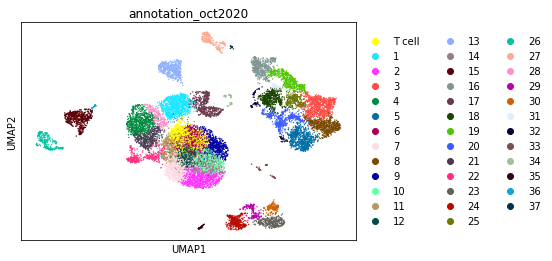

In [35]:
sc.pl.umap(
    organ_adata,
    color=["annotation_oct2020"],
    ncols=3,
)

# create celltype subcluster
This is just an example once the celltype annotations are done, how to subcluster cells in a celltype

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1094: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead

/data/yosef2/users/chenling/miniconda3/envs/scvi-tools/lib/python3.8/site-packages/anndata/_core/anndata.py:1192: FutureWarning:

is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead



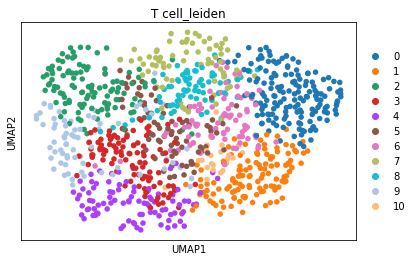

In [36]:
celltype = "T cell"
sub_organ_adata = organ_adata[organ_adata.obs["annotation_oct2020"] == celltype]
sc.pp.neighbors(sub_organ_adata, use_rep="X_scvi_decontX")
sc.tl.umap(
    sub_organ_adata,
)
sc.tl.leiden(sub_organ_adata, resolution=1, key_added="%s_leiden" % celltype)
sc.pl.umap(
    sub_organ_adata,
    color=["%s_leiden" % celltype],
    ncols=3,
)

In [37]:
sc.tl.rank_genes_groups(
    sub_organ_adata, groupby="%s_leiden" % celltype, method="wilcoxon"
)
sub_DE = FormatDE(sub_organ_adata.uns["rank_genes_groups"])

0


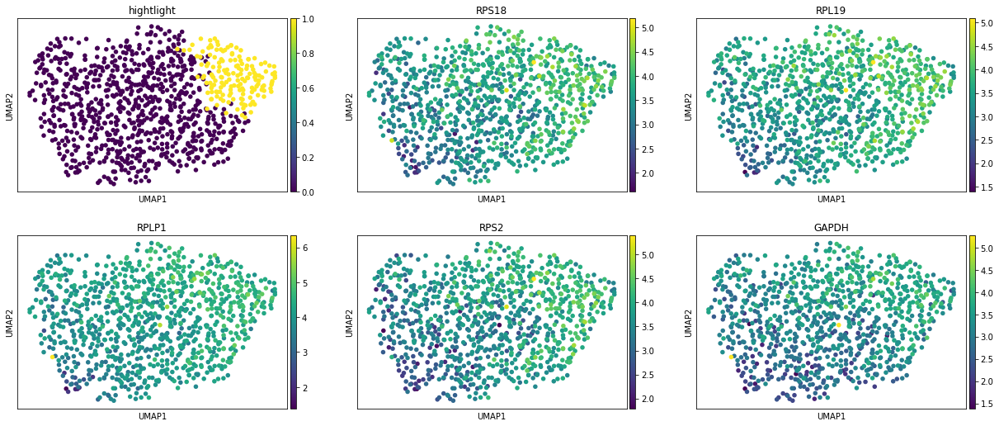

1


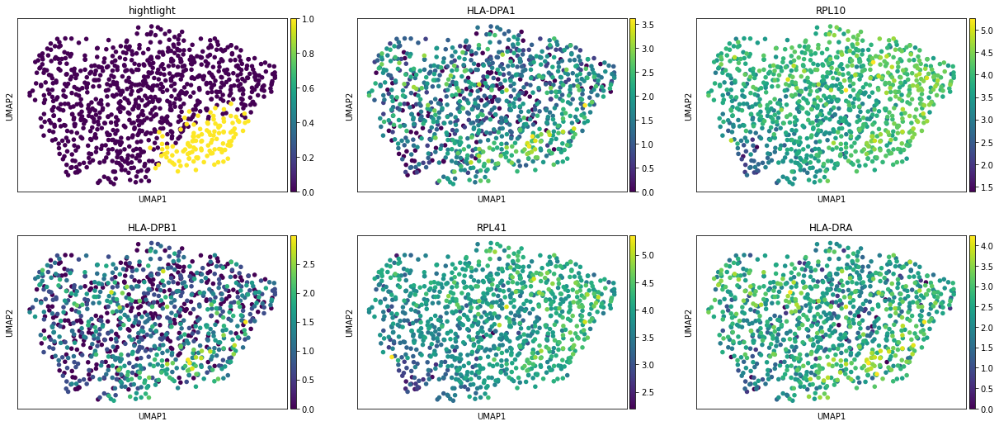

2


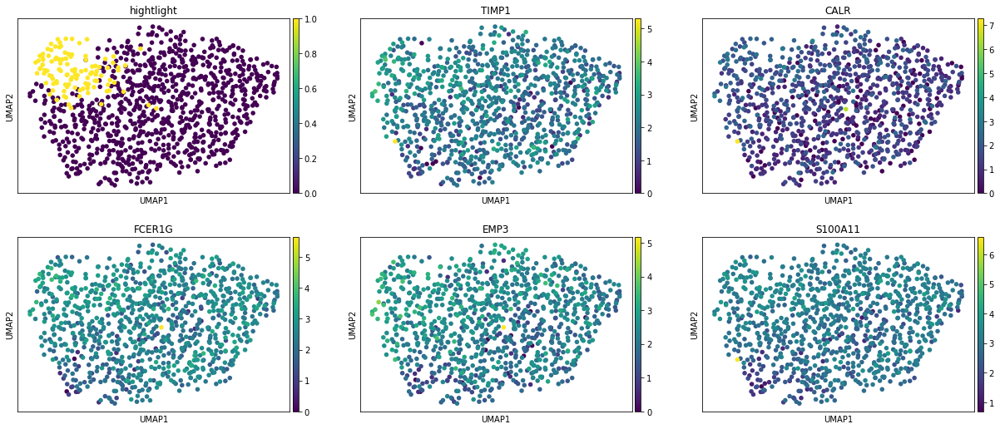

3


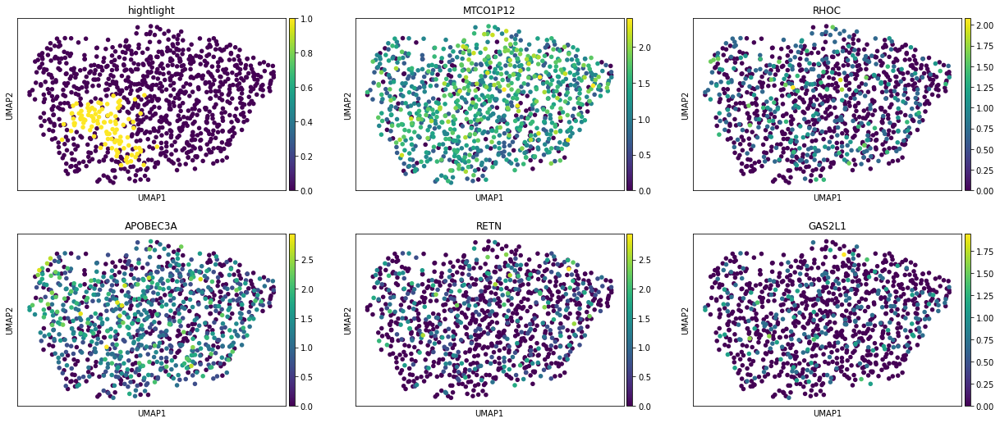

4


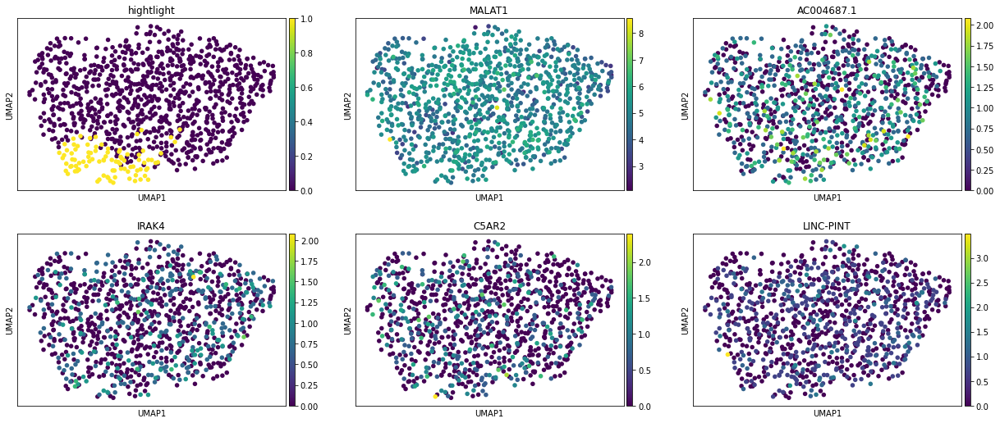

5


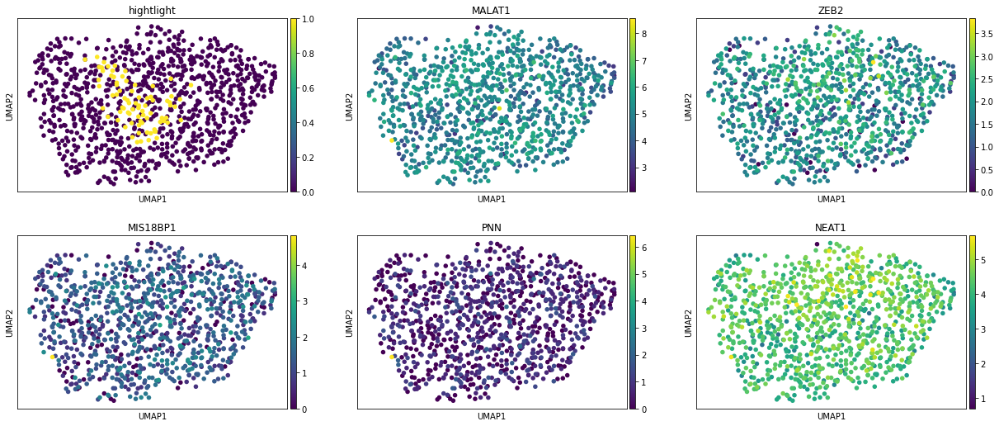

6


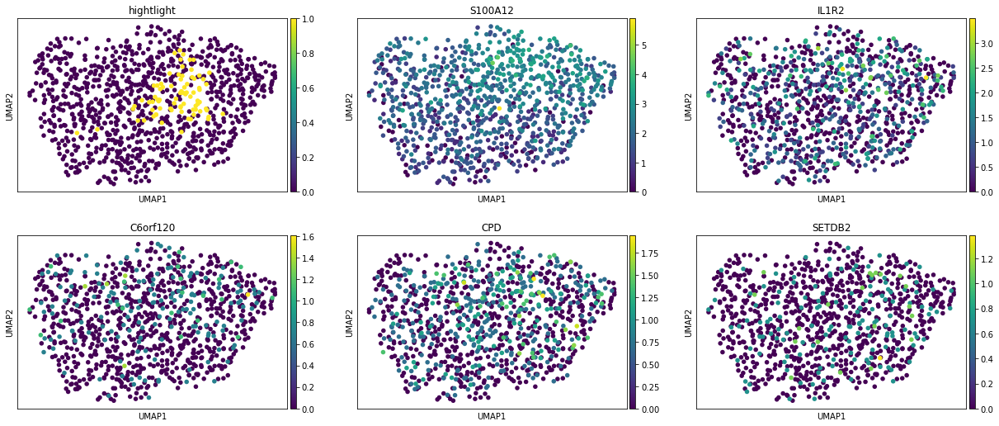

7


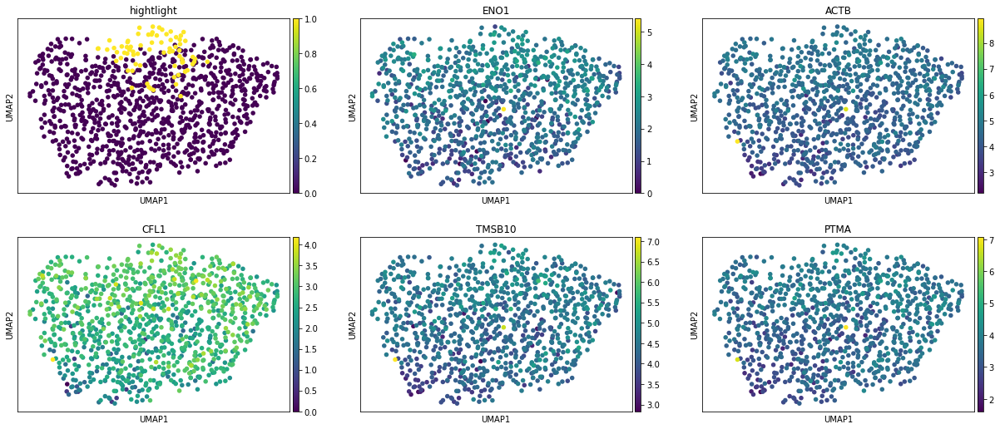

8


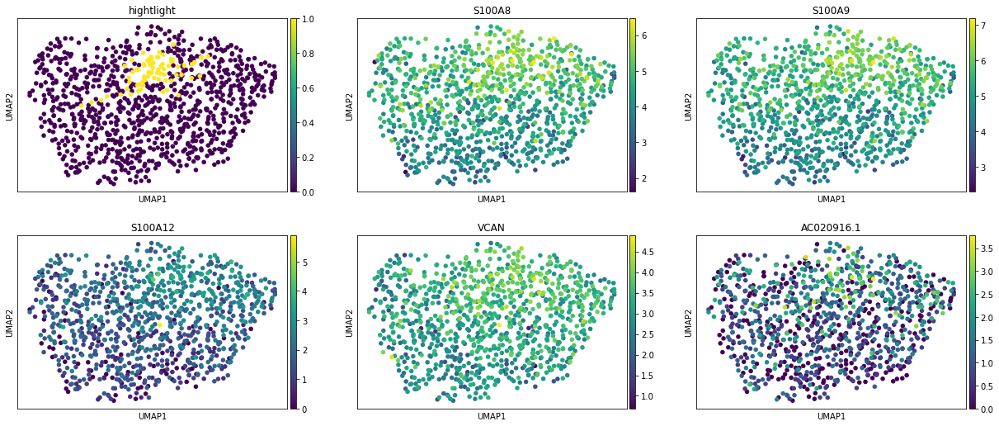

9


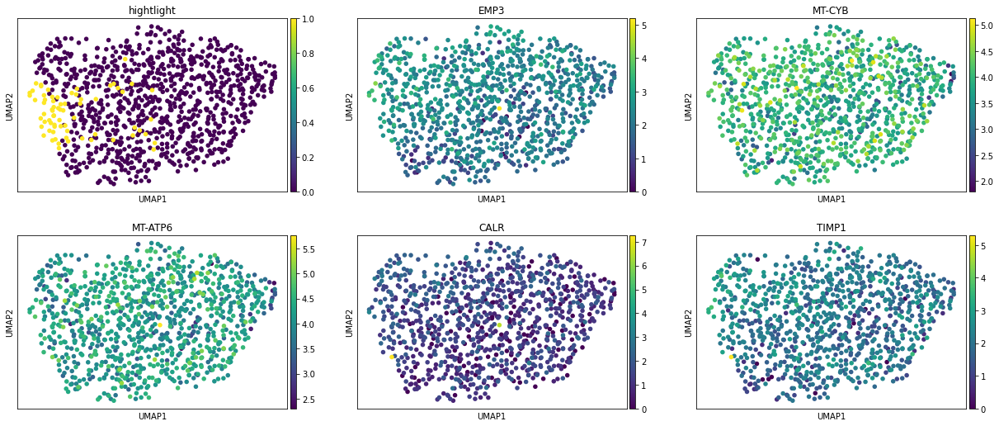

10


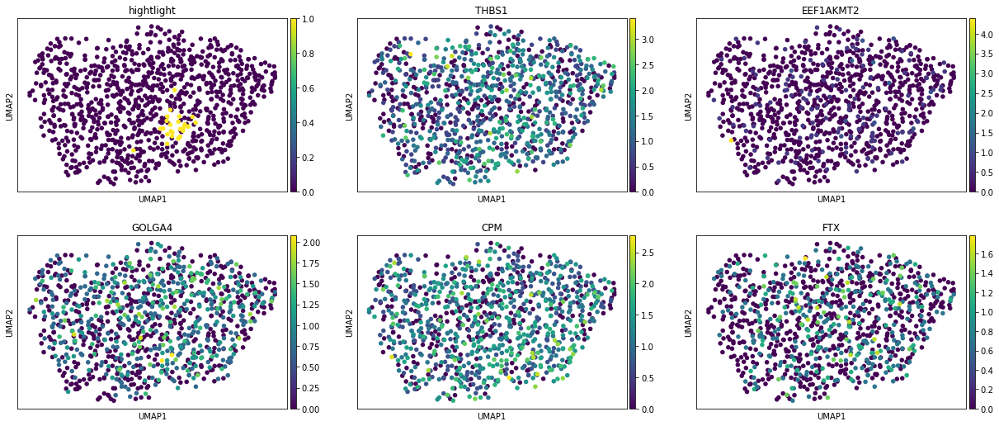

In [38]:
for x in sub_DE.keys():
    print(x)
    topgenes = list(sub_DE[x].T[:5].index)
    sub_organ_adata.obs["hightlight"] = sub_organ_adata.obs["%s_leiden" % celltype] == x
    sc.pl.umap(
        sub_organ_adata,
        color=["hightlight"] + topgenes,
        ncols=3,
    )

# manually create mapping between cell type and compartment (this is just an example)

In [39]:
organ_adata.obs["compartment_oct2020"] = organ_adata.obs["annotation_oct2020"].copy()
compartment_mapping = {"T cell": "Immune"}

This cell will automatically replace the leiden cluster names with cell type annotations

In [40]:
for c in compartment_mapping.keys():
    organ_adata.obs["compartment_oct2020"].replace(
        c, compartment_mapping[c], inplace=True
    )

# Visualize the results of the new compartment splitting

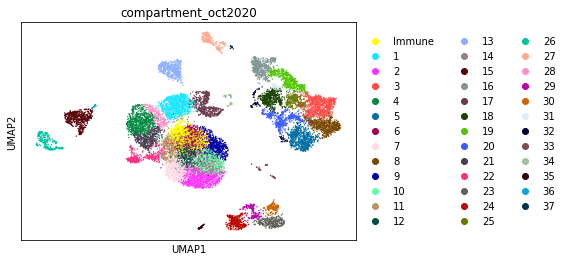

In [41]:
sc.pl.umap(
    organ_adata,
    color=["compartment_oct2020"],
    ncols=3,
)

# save data

In [42]:
organ_adata.write_h5ad(
    data_path + "decontX/organ_data/Pilot1_Pilot2.decontX.%s.h5ad" % organ
)